<a href="https://colab.research.google.com/github/amitesh30/bounding_box_regression_vggnet/blob/main/bounding_box_regression_vggnet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# import zipfile

# # Replace 'your_file.zip' with the name of your zip file.
# zip_file_path = '/content/drive/MyDrive/data-folder/HeliOrPlaneOrDrone.v6-planeheliv2.tensorflow.zip'

# # Replace 'destination_folder' with the folder where you want to extract the contents.
# destination_folder = '/content/drive/MyDrive/data-folder'

# with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
#     zip_ref.extractall(destination_folder)

# print(f"File '{zip_file_path}' has been successfully unzipped to '{destination_folder}'.")


File '/content/drive/MyDrive/data-folder/HeliOrPlaneOrDrone.v6-planeheliv2.tensorflow.zip' has been successfully unzipped to '/content/drive/MyDrive/data-folder'.


In [ ]:
# import the necessary packages
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.models import load_model
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np
import mimetypes
import argparse
import imutils
import cv2
import os

In [ ]:
def plt_imshow(title, image):
    # convert the image frame BGR to RGB color space and display it
	image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
	plt.imshow(image)
	plt.title(title)
	plt.grid(False)
	plt.show()

In [ ]:
Class = ["plane", "helicopter"]

In [ ]:
class Config:
    # define the base path to the input dataset and then use it to derive
    # the path to the images directory and annotation CSV file
    BASE_PATH = "dataset"
    IMAGES_PATH = r"/content/drive/MyDrive/data-folder/train"          #os.path.sep.join([BASE_PATH, "images"])
    ANNOTS_PATH =  r"/content/drive/MyDrive/data-folder/_annotations.csv"   #os.path.sep.join([BASE_PATH, "airplanes.csv"])

    # define the path to the base output directory
    BASE_OUTPUT = "output"

    # define the path to the output serialized model, model training plot,
    # and testing image filenames
    MODEL_PATH = os.path.sep.join([BASE_OUTPUT, "detector.h5"])
    PLOT_PATH = os.path.sep.join([BASE_OUTPUT, "plot.png"])
    TEST_FILENAMES = os.path.sep.join([BASE_OUTPUT, "test_images.txt"])

    # initialize our initial learning rate, number of epochs to train
    # for, and the batch size
    INIT_LR = 1e-4
    NUM_EPOCHS = 25
    BATCH_SIZE = 32

# instantiate the config class
config = Config()

In [ ]:
# load the contents of the CSV annotations file
print("[INFO] loading dataset...")
rows = open(config.ANNOTS_PATH).read().strip().split("\n")

# initialize the list of data (images), our target output predictions
# (bounding box coordinates), along with the filenames of the
# individual images
data = []
targets = []
filenames = []

[INFO] loading dataset...


In [ ]:
dataset1['filename'].value_counts()

youtube-212_jpg.rf.a4ad3c662fe01bdcc4f322339ecbfe95.jpg     14
youtube-40_jpg.rf.227e1263726f0a1dabf614b33d31a16f.jpg      12
youtube-39_jpg.rf.1a55674f99638dddc57d3245e4c7e9f7.jpg      11
2008_008053_jpg.rf.b540c87f12a5ceb3c36021d6acb19830.jpg     10
youtube-42_jpg.rf.d05822ddcb92d5cb4b96d864f227e340.jpg      10
                                                            ..
00000861_jpg.rf.2cea78ffb8dd3c7afe37e588be555425.jpg         1
0-20_jpg.rf.2d16b40431c50f2287ccfb2826c370d3.jpg             1
00000527_png_jpg.rf.2ce8260cb42a087a2e9d60433f41d771.jpg     1
2008_004704_jpg.rf.2bf7abd9718b72e410c5ca648e606255.jpg      1
0-331_jpg.rf.ec19948721f188f9325d43982403c30d.jpg            1
Name: filename, Length: 1687, dtype: int64

In [ ]:
import pandas as pd
dataset1 = pd.read_csv(r"/content/_annotations.csv")
dataset1.head()

,filename,width,height,class_label,xmin,ymin,xmax,ymax
0,00000862_jpg.rf.5fae4b616cb1e2a3cc2dd127157632...,640.0,640.0,plane,81.0,227.0,639.0,556.0
1,2008_005916_jpg.rf.5fcc695fcb7a0ca06d9ab5f03d1...,640.0,640.0,plane,0.0,96.0,589.0,454.0
2,0-142_jpg.rf.60492ac14e65287b4f613196c9473b59.jpg,640.0,640.0,plane,58.0,2.0,615.0,628.0
3,0-348_jpg.rf.5fbcdc3021d564db1bf2eb36114ecd96.jpg,640.0,640.0,plane,89.0,28.0,569.0,634.0
4,0-442_jpg.rf.6026a1b924ae7a2090ea0e07ba21f93e.jpg,640.0,640.0,plane,47.0,64.0,567.0,627.0


In [ ]:
from sklearn.preprocessing import LabelEncoder

# Assuming your class labels are in a DataFrame column named 'class_label'
class_labels = dataset1['class_label']  # Replace 'dataset1' with your DataFrame

# Initialize the label encoder
label_encoder = LabelEncoder()

# Fit and transform the class labels
encoded_labels = label_encoder.fit_transform(class_labels)

# Add the encoded labels as a new column in your DataFrame
dataset1['encoded_label'] = encoded_labels

# Print the DataFrame with encoded labels
print(dataset1[['class_label', 'encoded_label']])


     class_label  encoded_label
0          plane              1
1          plane              1
2          plane              1
3          plane              1
4          plane              1
...          ...            ...
2666  helicopter              0
2667       plane              1
2668         NaN              2
2669       plane              1
2670       plane              1

[2671 rows x 2 columns]


In [ ]:
dataset1.isna().sum()

filename         526
width            526
height           526
class_label      526
xmin             526
ymin             526
xmax             526
ymax             526
encoded_label      0
dtype: int64

In [ ]:
dataset1.dropna(inplace = True)

In [ ]:
dataset1.isna().sum()

filename         0
width            0
height           0
class_label      0
xmin             0
ymin             0
xmax             0
ymax             0
encoded_label    0
dtype: int64

In [ ]:
# # Define class labels for your new dataset
# class_labels = ["class1", "class2", "class3", ...]  # Add your class names

# # Update the paths and configuration for your new dataset
# class NewConfig(Config):
#     BASE_PATH = "new_dataset"  # Update to your dataset directory
#     IMAGES_PATH = os.path.sep.join([BASE_PATH, "images"])
#     ANNOTS_PATH = os.path.sep.join([BASE_PATH, "annotations.csv"])  # Update to your annotation file

# # Instantiate the configuration for your new dataset
# new_config = NewConfig()

# # Load and preprocess images from your new dataset
# new_image_paths = ["new_image1.jpg", "new_image2.jpg"]  # Replace with your image paths

# # Loop over images and apply object detection and label display code
# for new_image_path in new_image_paths:
#     # Load and preprocess the image
#     # Make predictions using the updated model
#     # Display labels on the image


In [ ]:

BASE_PATH = "/content/drive/MyDrive/data-folder"  # Update to your dataset directory
IMAGES_PATH = os.path.sep.join([BASE_PATH, "train"])
ANNOTS_PATH = os.path.sep.join([BASE_PATH, "_annotations.csv"])  # Update to your annotation file

In [ ]:
ANNOTS_PATH

'/content/drive/MyDrive/data-folder/_annotations.csv'

In [ ]:
# Import the required libraries
import pandas as pd
import os

class NewConfig(Config):
    BASE_PATH = r"/content/drive/MyDrive/data-folder"  # Update to your dataset directory
    IMAGES_PATH = r"/content/drive/MyDrive/data-folder/train"
    ANNOTS_PATH = dataset1 #os.path.sep.join([BASE_PATH, "_annotations.csv"])  # Update to your annotation file

# Instantiate the configuration for your new dataset
new_config = NewConfig()

# Define class labels (modify this based on your dataset)
class_labels = ["plane" ,"helicopter" ]

# Load the contents of the CSV annotations file
print("[INFO] loading dataset...")
data = []
targets = []  # Targets now include bounding box coordinates and class labels
filenames = []

# Loop over the rows in the DataFrame
for index, row in dataset1.iterrows():
    filename = row["filename"]
    width = row["width"]
    height = row["height"]
    class_label = row["encoded_label"]
    xmin = row["xmin"]
    ymin = row["ymin"]
    xmax = row["xmax"]
    ymax = row["ymax"]

    # Derive the path to the input image, load the image, and get its dimensions
    image_path = os.path.join(fr"/content/drive/MyDrive/data-folder/train/{filename}")  # Update the image directory path
    image = cv2.imread(image_path)
    # (h, w) = image.shape[:2]

    # Scale the bounding box coordinates relative to the image dimensions
    startX = float(xmin) / width
    startY = float(ymin) / height
    endX = float(xmax) / width
    endY = float(ymax) / height

    # Load and preprocess the image
    image = load_img(image_path, target_size=(224, 224))  # Update preprocessing as needed
    image = img_to_array(image)

    # Update the list of data, targets, and filenames
    data.append(image)
    targets.append((startX, startY, endX, endY, class_label))  # Add class label
    filenames.append(filename)

[INFO] loading dataset...


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

# Convert the data and targets to NumPy arrays, scaling the input pixel intensities
data = np.array(data, dtype="float32") / 255.0
targets = np.array(targets, dtype="float32")

# Partition the data into training and testing splits using 90% for training and 10% for testing
split = train_test_split(data, targets, filenames, test_size=0.10, random_state=42)

# Unpack the data split
(trainImages, testImages) = split[:2]
(trainTargets, testTargets) = split[2:4]
(trainFilenames, testFilenames) = split[4:]

# Save the testing filenames to a file
print("[INFO] saving testing filenames...")
with open("/content/drive/MyDrive/data-folder/Output/TestFiles.txt", "w") as f:  # Use the new_config to save the testing filenames
    f.write("\n".join(testFilenames))


[INFO] saving testing filenames...


In [ ]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Input, Flatten, Dense
from tensorflow.keras.models import Model

# Load the VGG16 network, ensuring the head FC layers are left off
vgg = VGG16(include_top=False, input_tensor=Input(shape=(224, 224, 3)))

# Freeze all VGG layers so they will not be updated during training
vgg.trainable = False

# Flatten the max-pooling output of VGG
flatten = vgg.output
flatten = Flatten()(flatten)

# Construct a fully-connected layer header to output the predicted bounding box coordinates
bboxHead = Dense(128, activation="relu")(flatten)
bboxHead = Dense(64, activation="relu")(bboxHead)
bboxHead = Dense(32, activation="relu")(bboxHead)
bboxHead = Dense(4, activation="sigmoid", name="bounding_box")(bboxHead)

# Add an additional branch for predicting target labels
labelHead = Dense(64, activation="relu")(flatten)
labelHead = Dense(32, activation="relu")(labelHead)
labelHead = Dense(2, activation="softmax", name="label")(labelHead)  # Replace `num_classes` with the actual number of classes

# Construct the model with both bounding box and label outputs
model = Model(inputs=vgg.input, outputs=[bboxHead, labelHead])


In [ ]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import MeanSquaredError

# Initialize the optimizer and compile the model
opt = Adam(learning_rate=Config.INIT_LR)

# Define separate losses and metrics for bounding box coordinates and class prediction
losses = {
    "bounding_box": "mse",  # Mean Squared Error for bounding box regression
    "label": "categorical_crossentropy"  # Use categorical cross-entropy for class prediction
}

metrics = {
    "bounding_box": MeanSquaredError(),  # Use MeanSquaredError for bounding box regression
    "label": "accuracy"  # You can use accuracy for class prediction
}

model.compile(loss=losses, optimizer=opt, metrics=metrics)


In [ ]:
from tensorflow.keras.utils import to_categorical

# Assuming that your class labels are integers from 0 to num_classes - 1
num_classes = 2  # Replace with the actual number of classes

# Convert your class labels to one-hot encoding
train_class_labels = to_categorical(trainTargets[:, 4], num_classes=num_classes)
test_class_labels = to_categorical(testTargets[:, 4], num_classes=num_classes)

# Modify the training data accordingly
H = model.fit(
    trainImages, {"bounding_box": trainTargets[:, :4], "label": train_class_labels},
    validation_data=(testImages, {"bounding_box": testTargets[:, :4], "label": test_class_labels}),
    batch_size=Config.BATCH_SIZE,
    epochs=150,
    verbose=1
)


Epoch 1/150
61/61 [==============================] - 12s 168ms/step - loss: 0.0309 - bounding_box_loss: 0.0131 - label_loss: 0.0178 - bounding_box_mean_squared_error: 0.0131 - label_accuracy: 0.9933 - val_loss: 0.1488 - val_bounding_box_loss: 0.0286 - val_label_loss: 0.1202 - val_bounding_box_mean_squared_error: 0.0286 - val_label_accuracy: 0.9674
Epoch 2/150
61/61 [==============================] - 9s 154ms/step - loss: 0.0306 - bounding_box_loss: 0.0132 - label_loss: 0.0174 - bounding_box_mean_squared_error: 0.0132 - label_accuracy: 0.9933 - val_loss: 0.1452 - val_bounding_box_loss: 0.0291 - val_label_loss: 0.1162 - val_bounding_box_mean_squared_error: 0.0291 - val_label_accuracy: 0.9721
Epoch 3/150
61/61 [==============================] - 9s 148ms/step - loss: 0.0281 - bounding_box_loss: 0.0127 - label_loss: 0.0154 - bounding_box_mean_squared_error: 0.0127 - label_accuracy: 0.9953 - val_loss: 0.1430 - val_bounding_box_loss: 0.0293 - val_label_loss: 0.1137 - val_bounding_box_mean_squ

[INFO] saving object detector model...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


ValueError: ignored

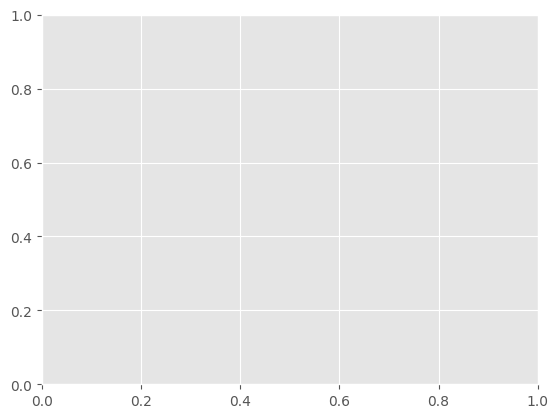

In [ ]:
# serialize the model to disk
print("[INFO] saving object detector model...")
model.save(config.MODEL_PATH, save_format="h5")

# plot the model training history
N = config.NUM_EPOCHS
plt.style.use("ggplot")
plt.figure()
plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
plt.title("Bounding Box Regression Loss on Training Set")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="lower left")
plt.show()

In [ ]:
# # construct the argument parser and parse the arguments
# ap = argparse.ArgumentParser()
# ap.add_argument("-i", "--input", required=True,
# 	help="path to input image/text file of image filenames")
# args = vars(ap.parse_args())

# since we are using Jupyter Notebooks we can replace our argument
# parsing code with *hard coded* arguments and values
args = {
    "input": "/content/drive/MyDrive/data-folder/Output/TestFiles.txt"
}

In [ ]:
# determine the input file type, but assume that we're working with
# single input image
filetype = mimetypes.guess_type(args["input"])[0]
imagePaths = [args["input"]]

# if the file type is a text file, then we need to process *multiple*
# images
if "text/plain" == filetype:
	# load the filenames in our testing file and initialize our list
	# of image paths
	filenames = open(args["input"]).read().strip().split("\n")
	imagePaths = []

	# loop over the filenames
	for f in filenames:
		# construct the full path to the image filename and then
		# update our image paths list
		p = os.path.sep.join([config.IMAGES_PATH, f])
		imagePaths.append(p)

[INFO] loading object detector...
1/1 [==============================] - 0s 177ms/step


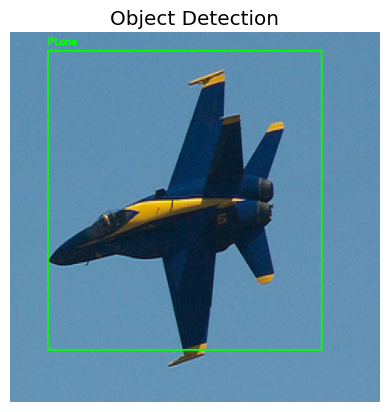

1/1 [==============================] - 0s 23ms/step


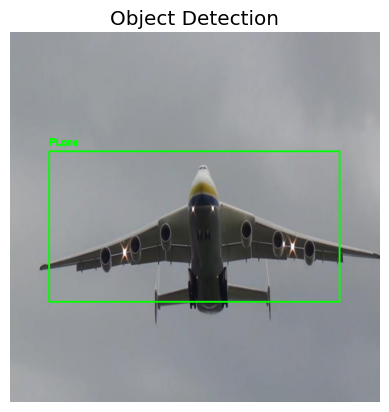

1/1 [==============================] - 0s 20ms/step


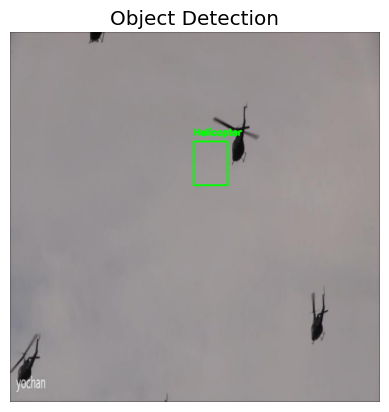

1/1 [==============================] - 0s 25ms/step


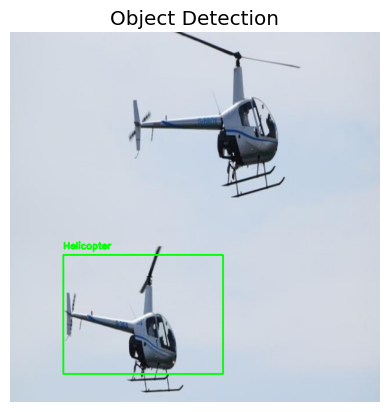

1/1 [==============================] - 0s 26ms/step


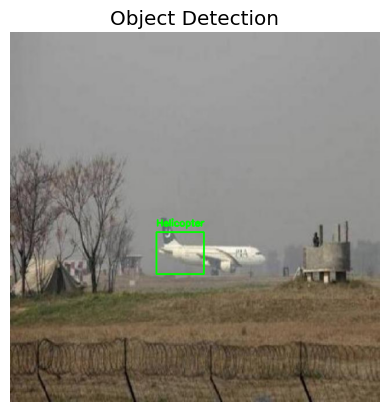

1/1 [==============================] - 0s 19ms/step


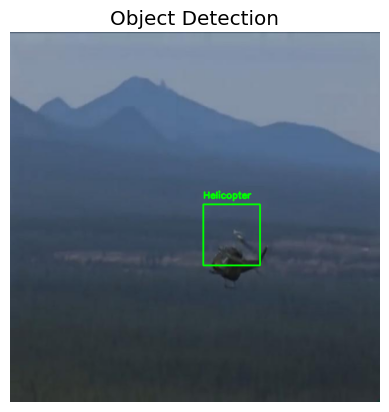

1/1 [==============================] - 0s 22ms/step


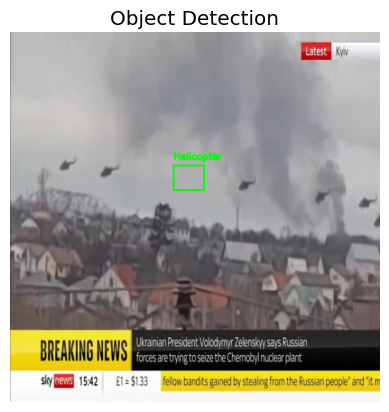

1/1 [==============================] - 0s 19ms/step


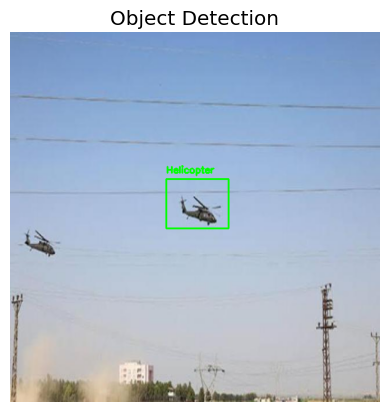

1/1 [==============================] - 0s 18ms/step


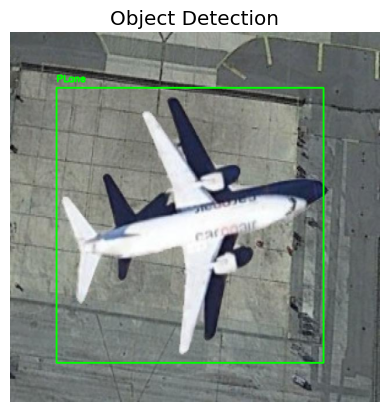

1/1 [==============================] - 0s 19ms/step


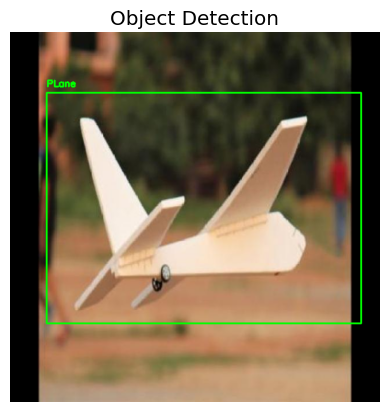

1/1 [==============================] - 0s 19ms/step


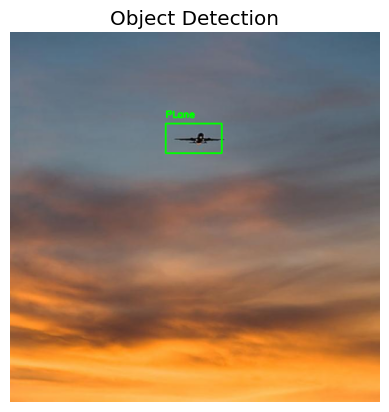

1/1 [==============================] - 0s 27ms/step


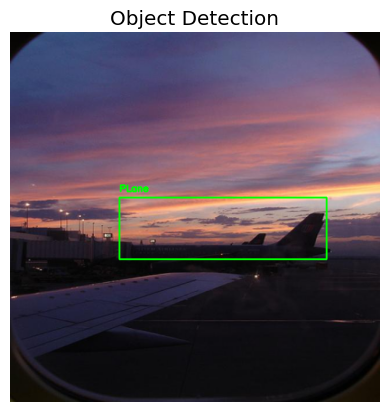

1/1 [==============================] - 0s 93ms/step


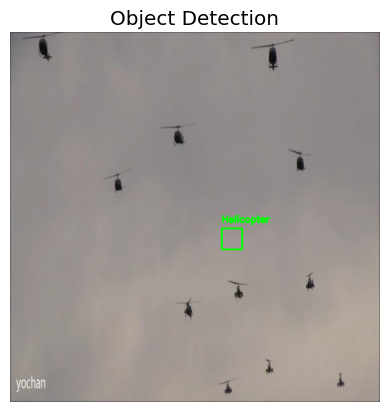

1/1 [==============================] - 0s 71ms/step


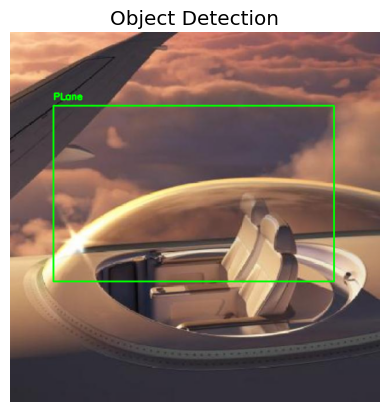

1/1 [==============================] - 0s 134ms/step


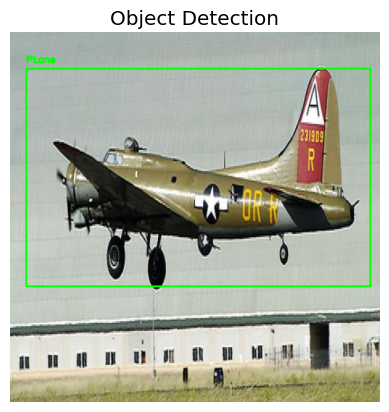

1/1 [==============================] - 0s 108ms/step


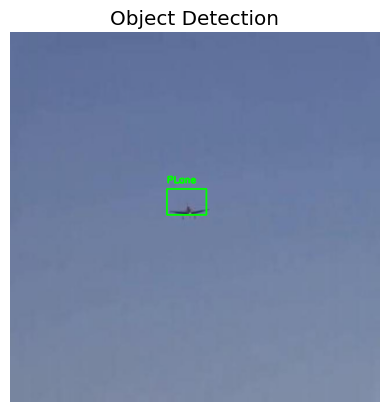

1/1 [==============================] - 0s 32ms/step


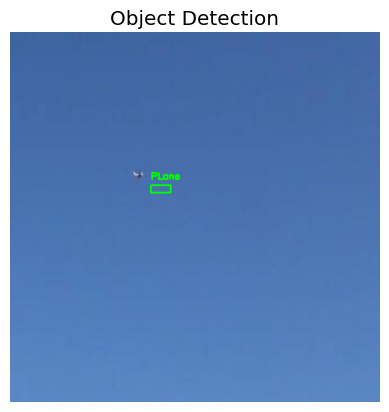

1/1 [==============================] - 0s 28ms/step


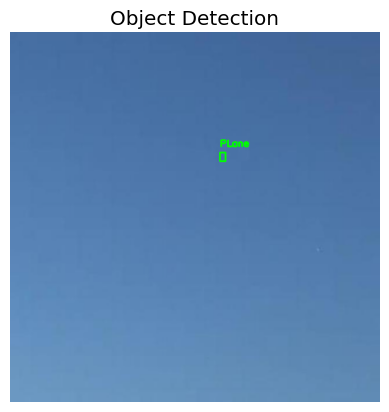

1/1 [==============================] - 0s 21ms/step


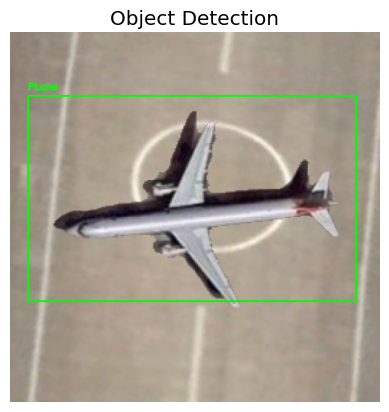

1/1 [==============================] - 0s 22ms/step


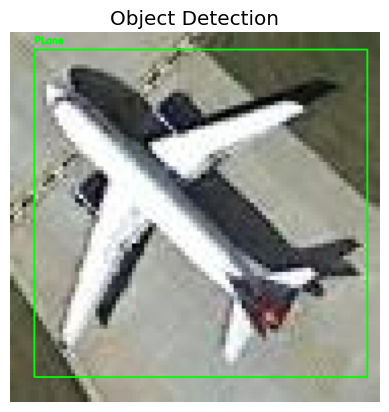

1/1 [==============================] - 0s 26ms/step


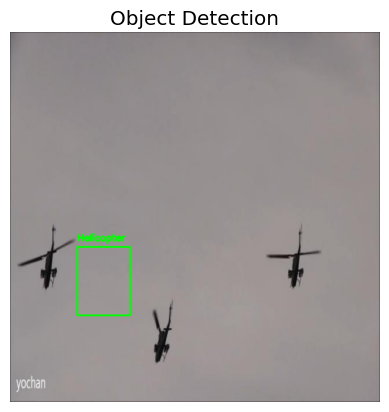

1/1 [==============================] - 0s 26ms/step


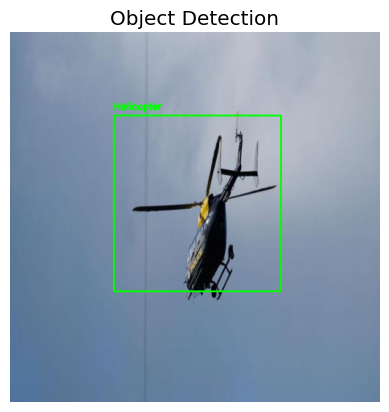

1/1 [==============================] - 0s 21ms/step


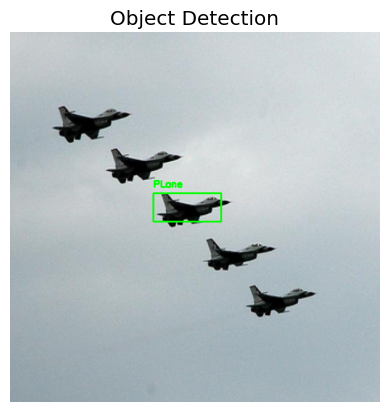

1/1 [==============================] - 0s 23ms/step


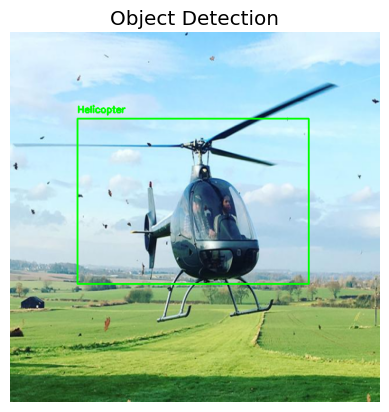

1/1 [==============================] - 0s 29ms/step


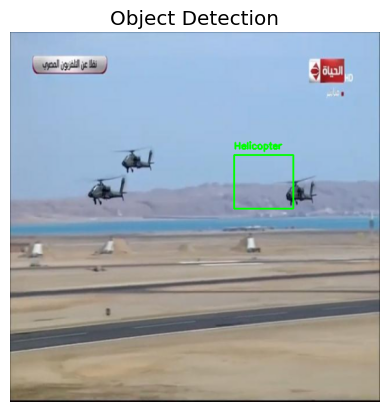

1/1 [==============================] - 0s 24ms/step


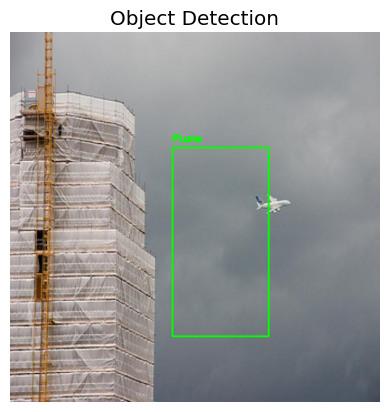

1/1 [==============================] - 0s 29ms/step


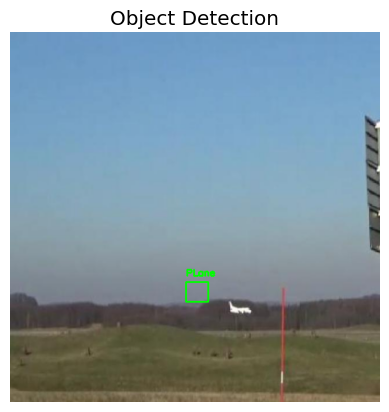

1/1 [==============================] - 0s 28ms/step


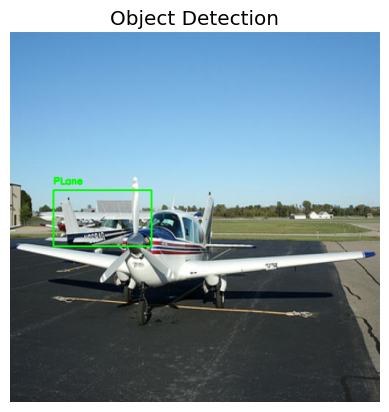

1/1 [==============================] - 0s 29ms/step


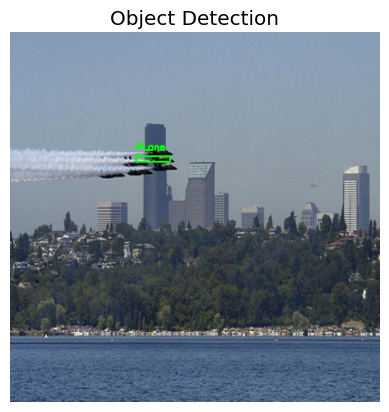

1/1 [==============================] - 0s 27ms/step


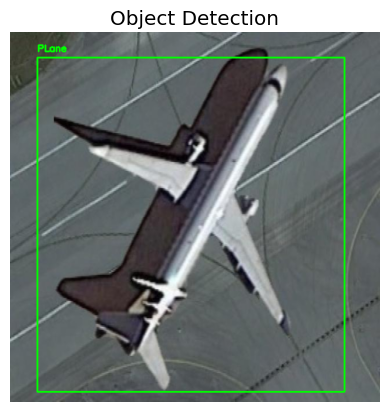

1/1 [==============================] - 0s 30ms/step


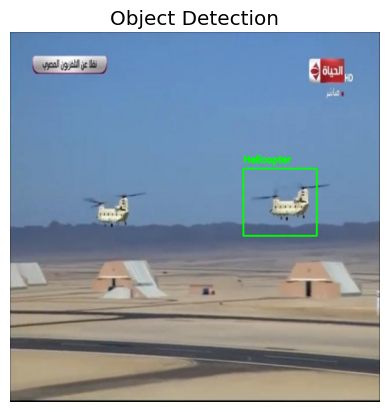

1/1 [==============================] - 0s 36ms/step


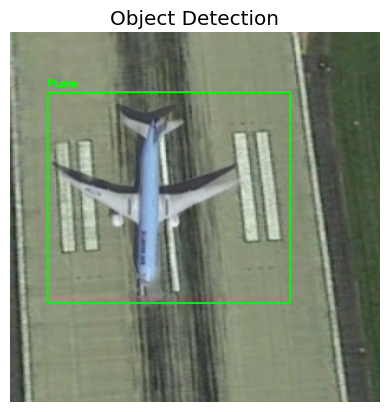

1/1 [==============================] - 0s 92ms/step


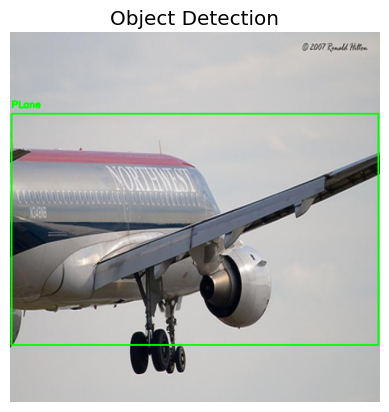

1/1 [==============================] - 0s 27ms/step


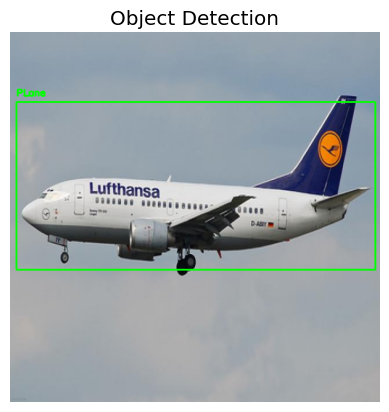

1/1 [==============================] - 0s 32ms/step


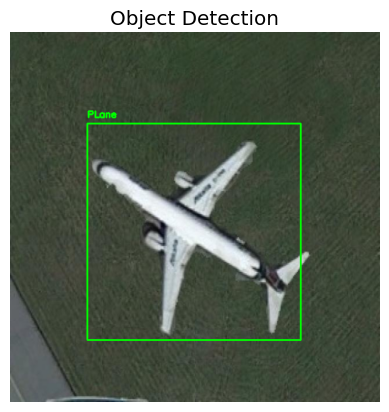

1/1 [==============================] - 0s 32ms/step


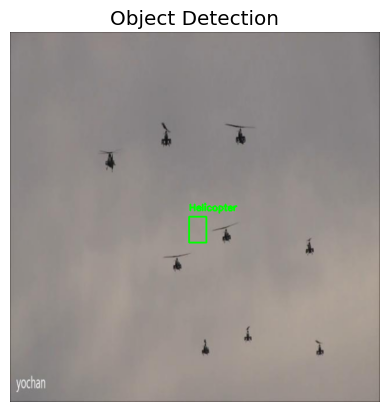

1/1 [==============================] - 0s 32ms/step


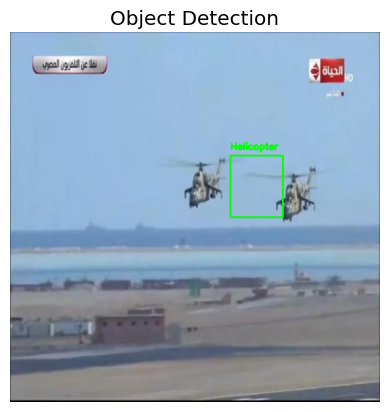

1/1 [==============================] - 0s 26ms/step


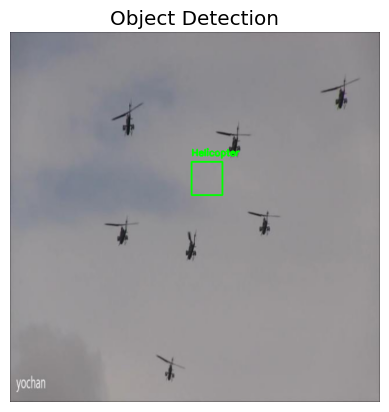

1/1 [==============================] - 0s 28ms/step


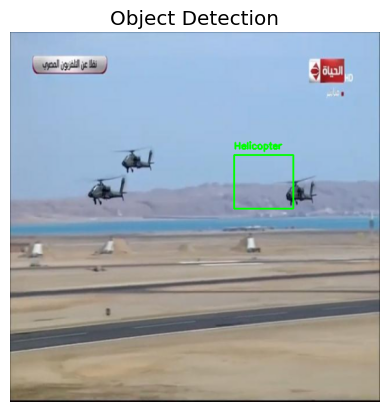

1/1 [==============================] - 0s 28ms/step


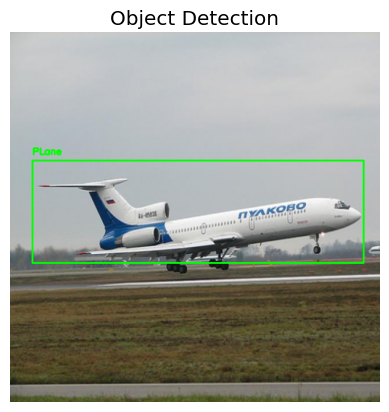

1/1 [==============================] - 0s 32ms/step


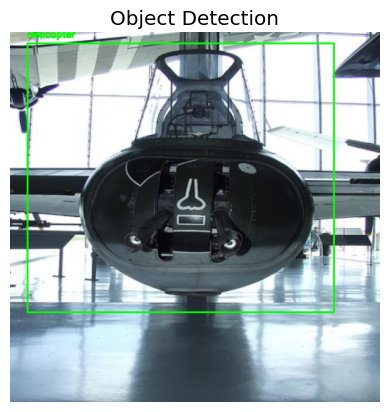

1/1 [==============================] - 0s 36ms/step


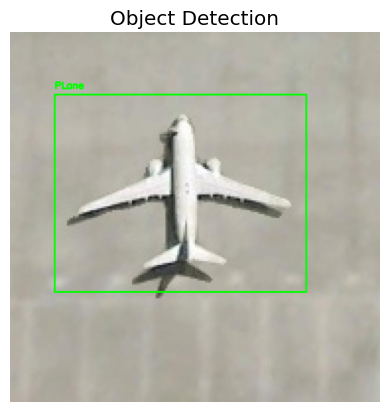

1/1 [==============================] - 0s 50ms/step


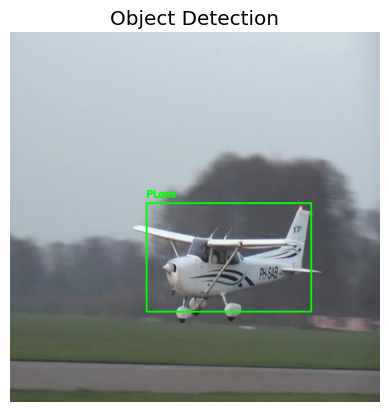

1/1 [==============================] - 0s 33ms/step


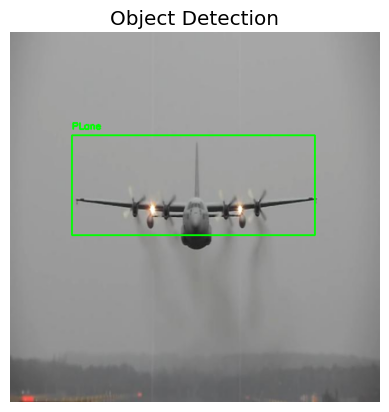

1/1 [==============================] - 0s 38ms/step


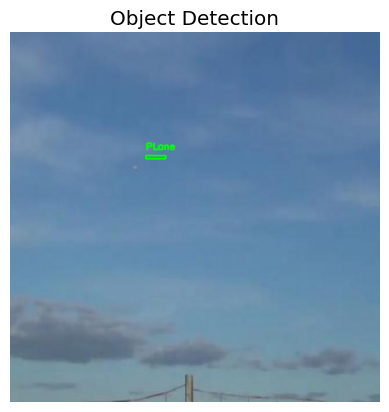

1/1 [==============================] - 0s 38ms/step


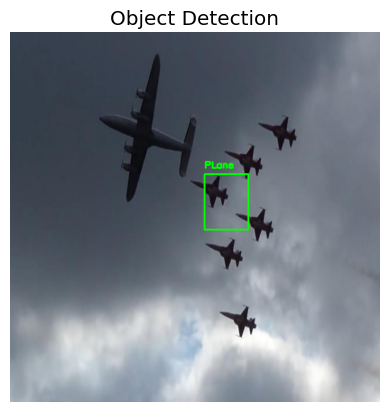

1/1 [==============================] - 0s 61ms/step


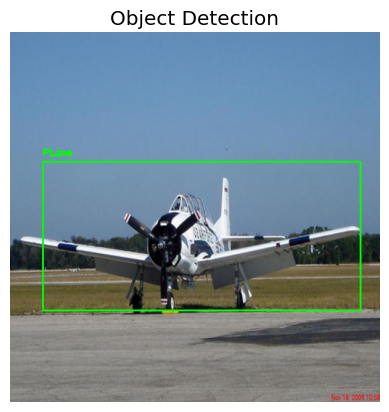

1/1 [==============================] - 0s 40ms/step


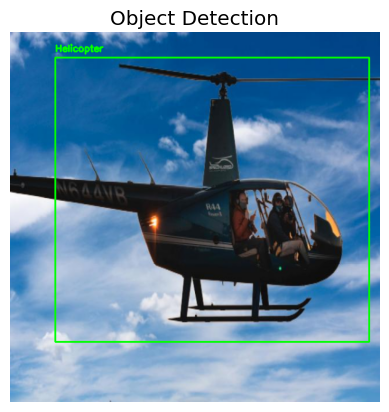

1/1 [==============================] - 0s 41ms/step


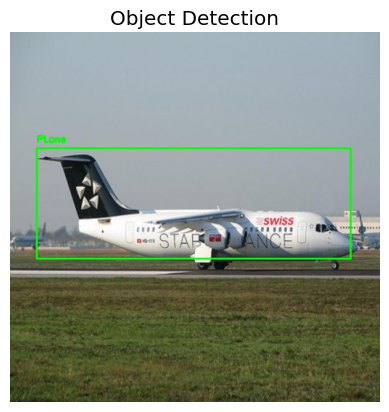

1/1 [==============================] - 0s 33ms/step


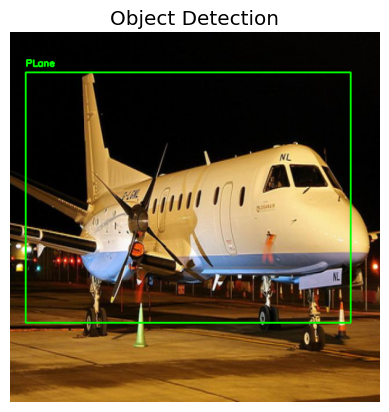

1/1 [==============================] - 0s 55ms/step


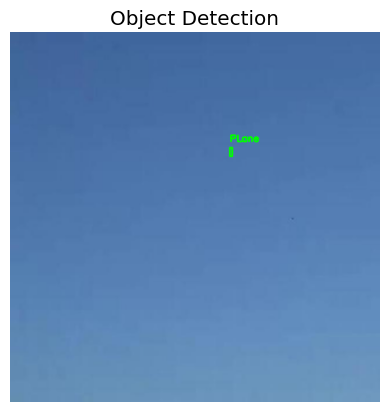

1/1 [==============================] - 0s 60ms/step


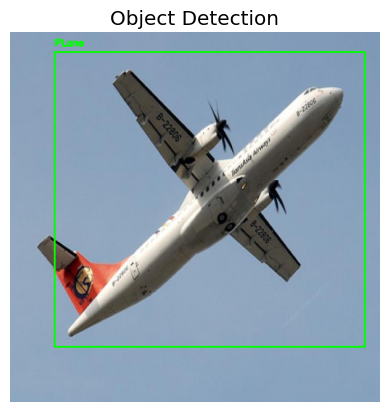

1/1 [==============================] - 0s 31ms/step


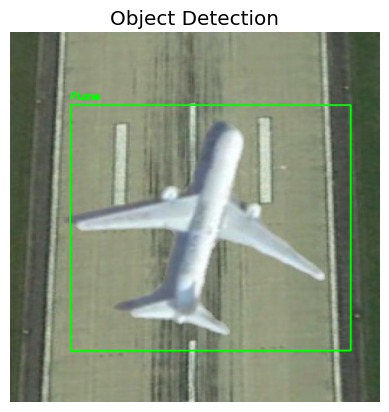

1/1 [==============================] - 0s 35ms/step


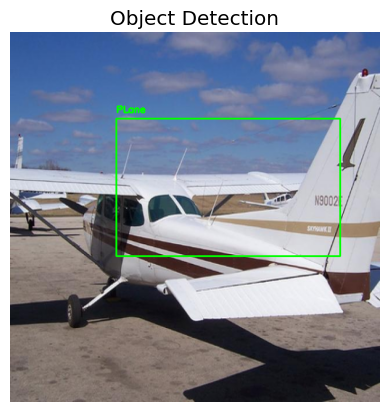

1/1 [==============================] - 0s 34ms/step


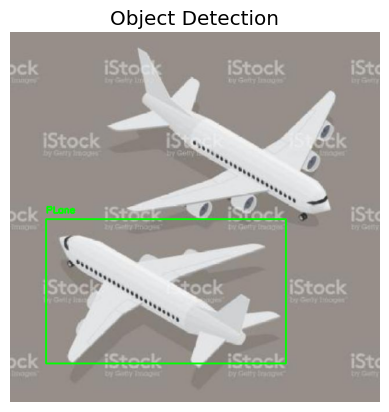

1/1 [==============================] - 0s 29ms/step


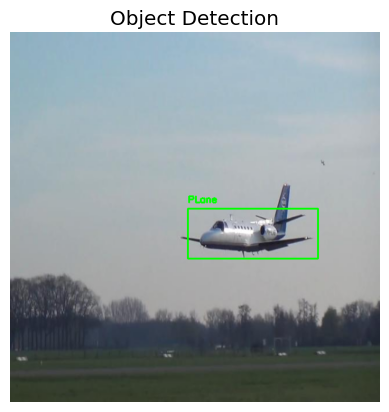

1/1 [==============================] - 0s 50ms/step


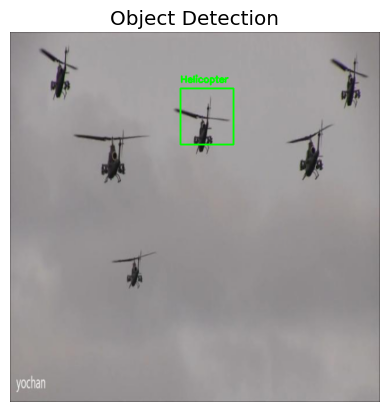

1/1 [==============================] - 0s 58ms/step


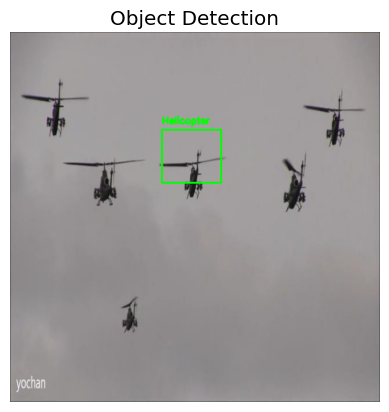

1/1 [==============================] - 0s 54ms/step


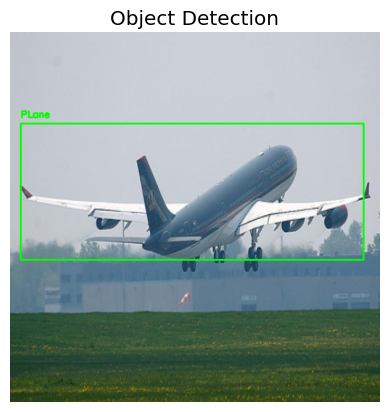

1/1 [==============================] - 0s 26ms/step


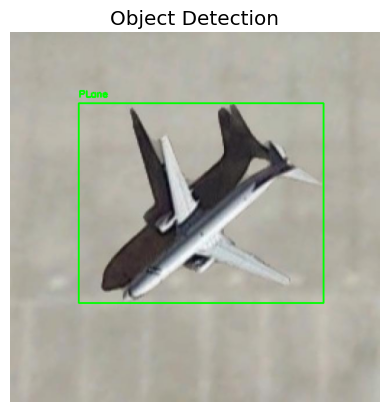

1/1 [==============================] - 0s 27ms/step


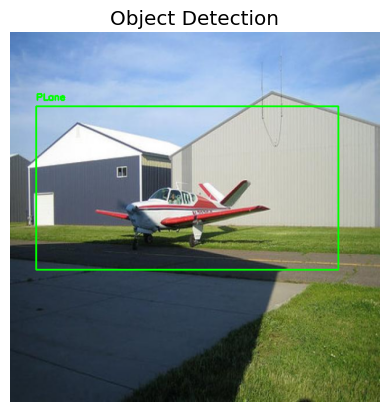

1/1 [==============================] - 0s 26ms/step


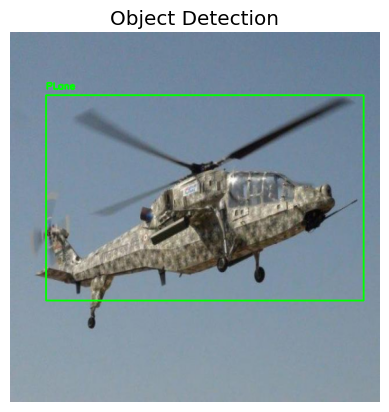

1/1 [==============================] - 0s 26ms/step


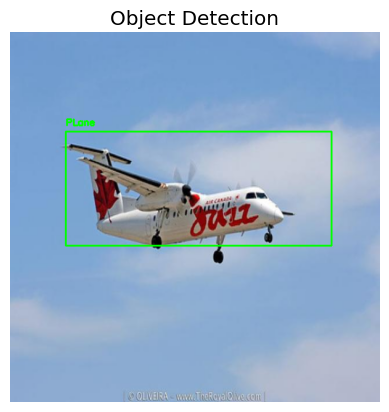

1/1 [==============================] - 0s 27ms/step


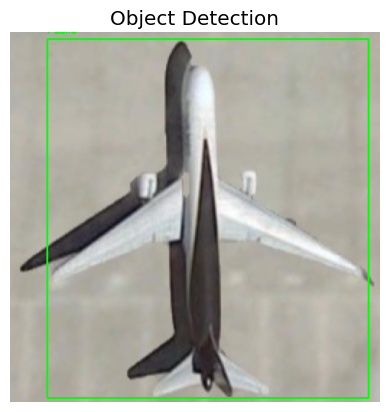

1/1 [==============================] - 0s 26ms/step


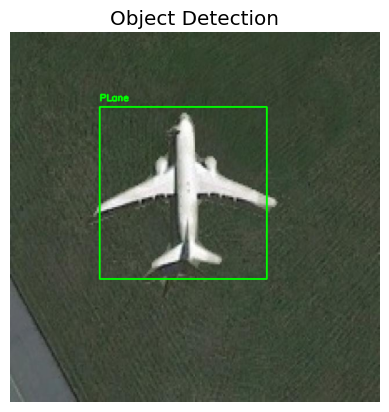

1/1 [==============================] - 0s 28ms/step


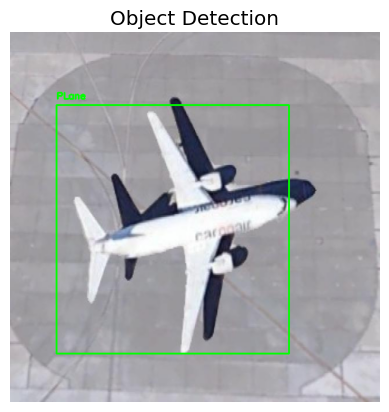

1/1 [==============================] - 0s 42ms/step


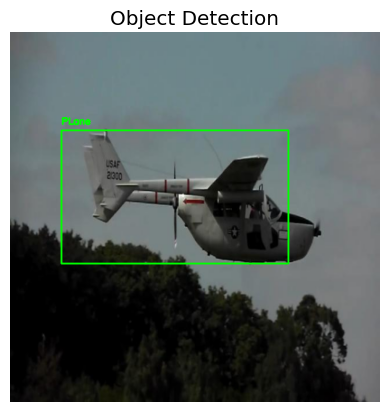

1/1 [==============================] - 0s 24ms/step


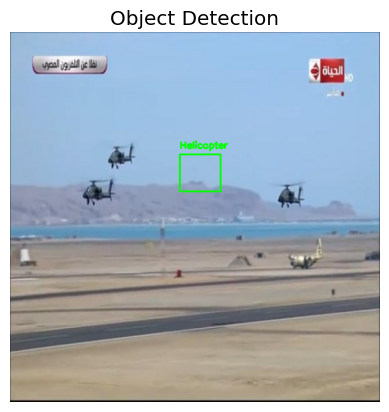

1/1 [==============================] - 0s 26ms/step


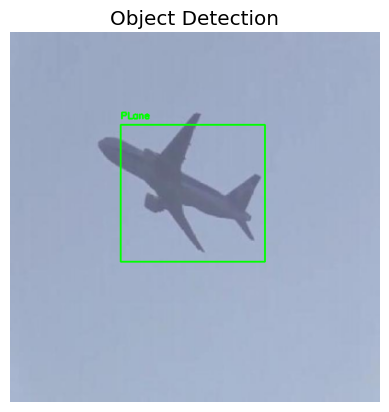

1/1 [==============================] - 0s 28ms/step


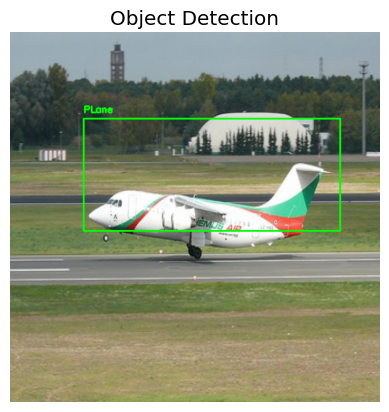

1/1 [==============================] - 0s 30ms/step


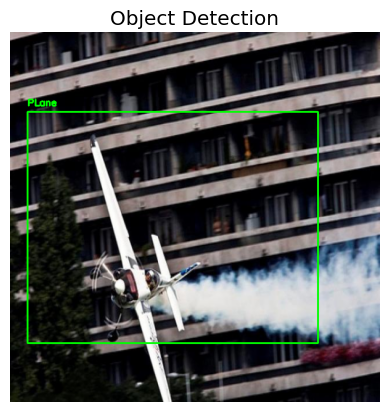

1/1 [==============================] - 0s 29ms/step


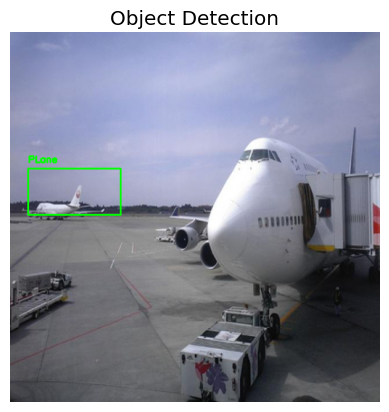

1/1 [==============================] - 0s 29ms/step


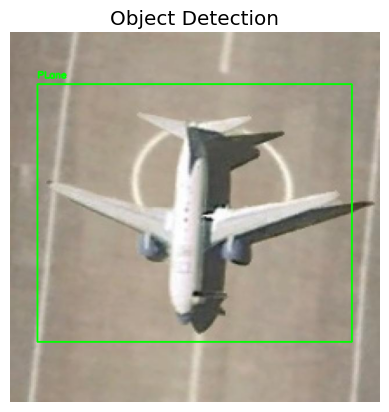

1/1 [==============================] - 0s 25ms/step


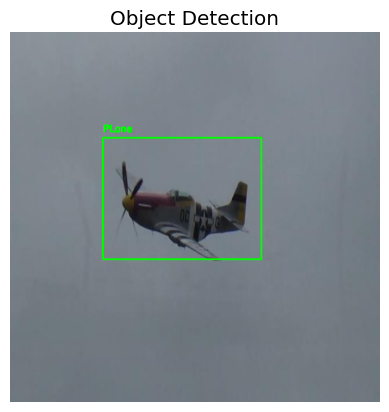

1/1 [==============================] - 0s 30ms/step


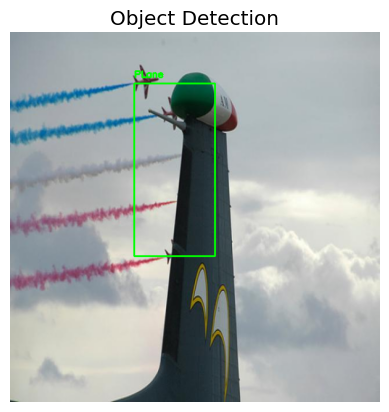

1/1 [==============================] - 0s 25ms/step


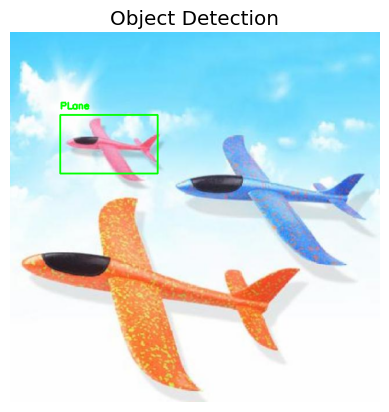

1/1 [==============================] - 0s 26ms/step


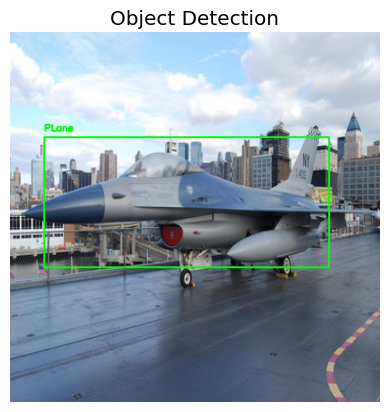

1/1 [==============================] - 0s 26ms/step


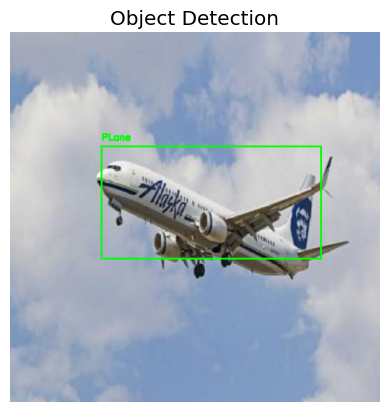

1/1 [==============================] - 0s 27ms/step


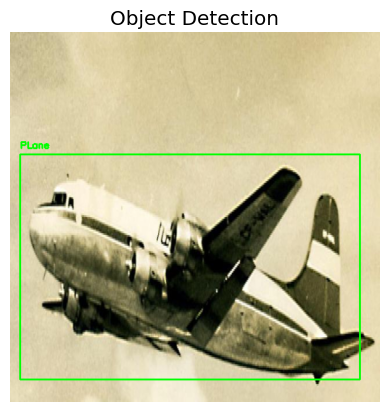

1/1 [==============================] - 0s 26ms/step


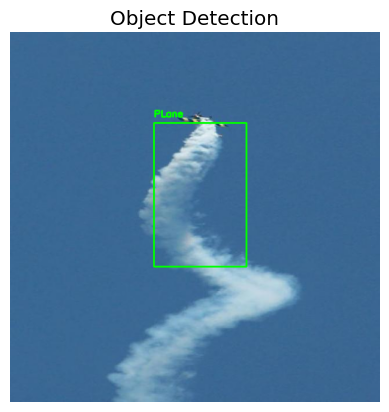

1/1 [==============================] - 0s 25ms/step


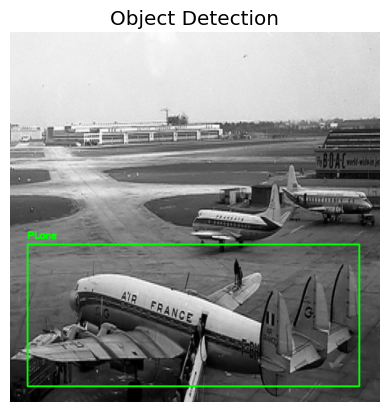

1/1 [==============================] - 0s 30ms/step


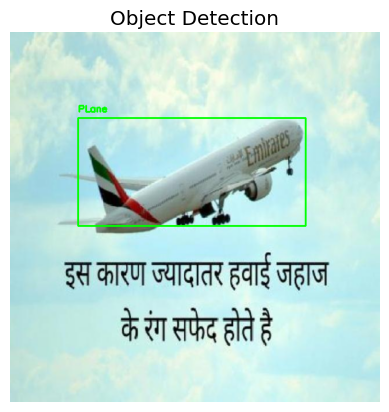

1/1 [==============================] - 0s 26ms/step


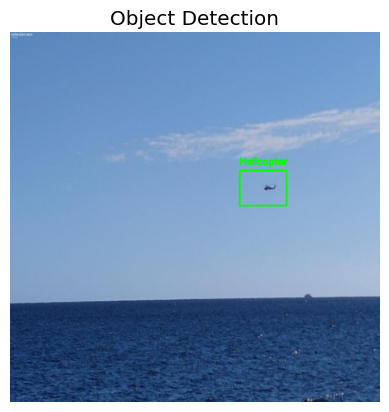

1/1 [==============================] - 0s 30ms/step


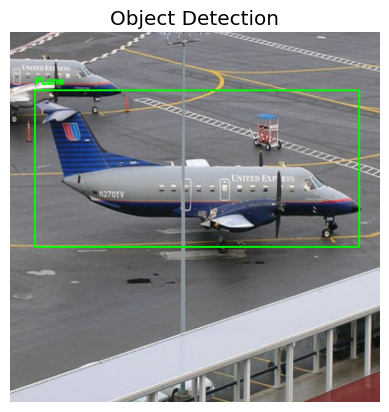

1/1 [==============================] - 0s 37ms/step


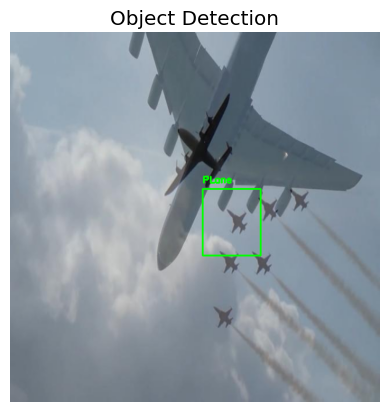

1/1 [==============================] - 0s 27ms/step


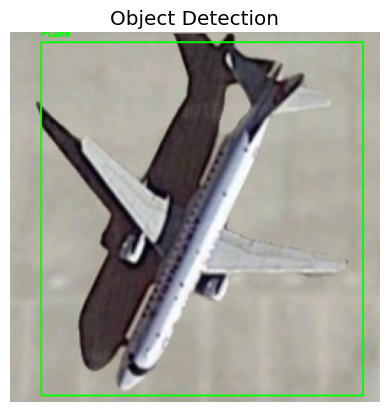

1/1 [==============================] - 0s 41ms/step


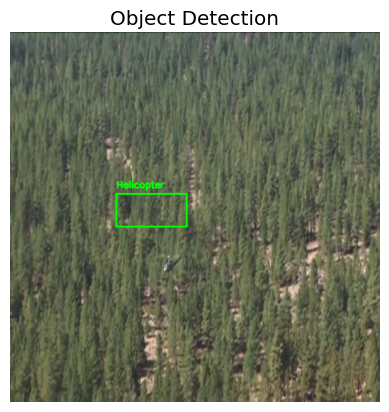

1/1 [==============================] - 0s 27ms/step


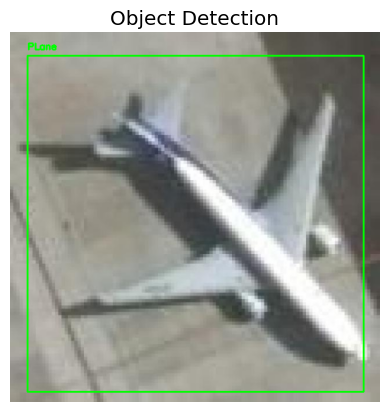

1/1 [==============================] - 0s 29ms/step


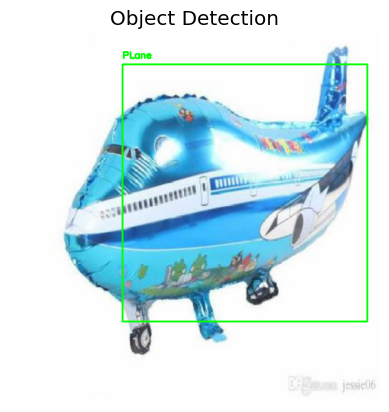

1/1 [==============================] - 0s 26ms/step


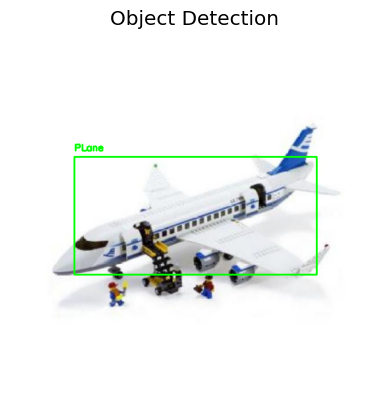

1/1 [==============================] - 0s 58ms/step


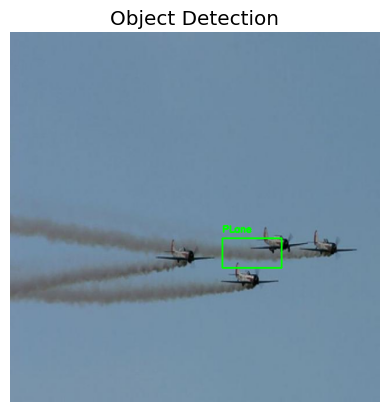

1/1 [==============================] - 0s 37ms/step


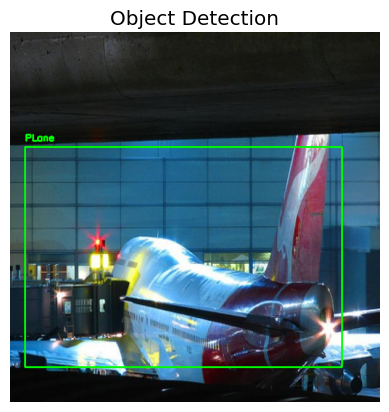

1/1 [==============================] - 0s 26ms/step


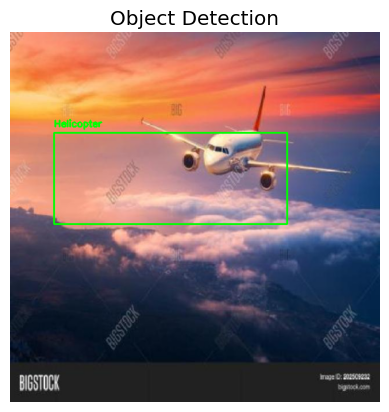

1/1 [==============================] - 0s 35ms/step


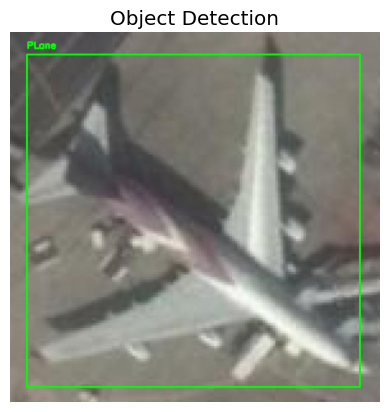

1/1 [==============================] - 0s 27ms/step


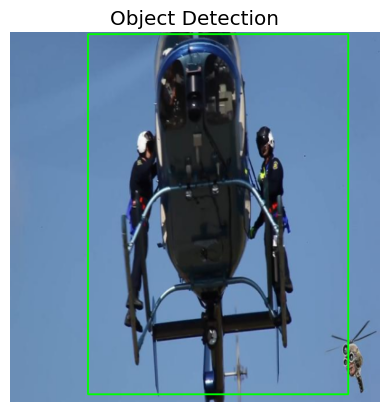

1/1 [==============================] - 0s 32ms/step


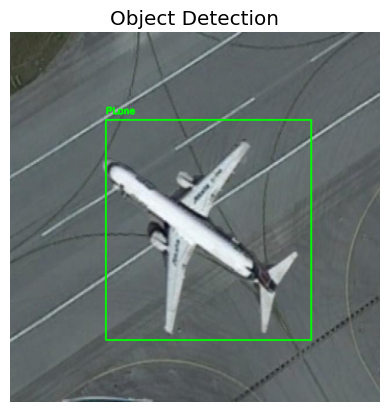

1/1 [==============================] - 0s 59ms/step


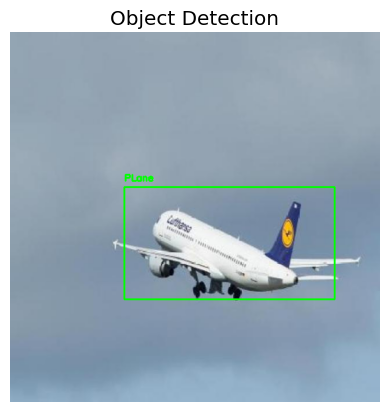

1/1 [==============================] - 0s 38ms/step


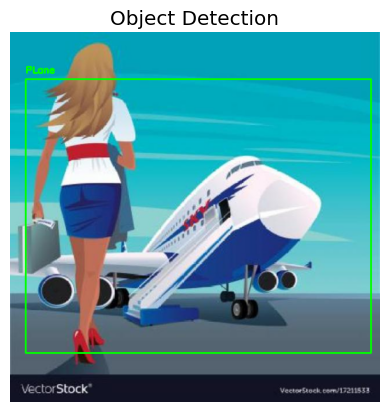

1/1 [==============================] - 0s 28ms/step


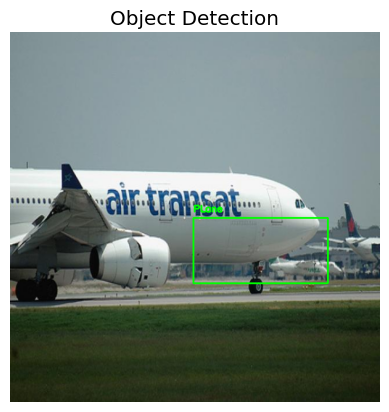

1/1 [==============================] - 0s 27ms/step


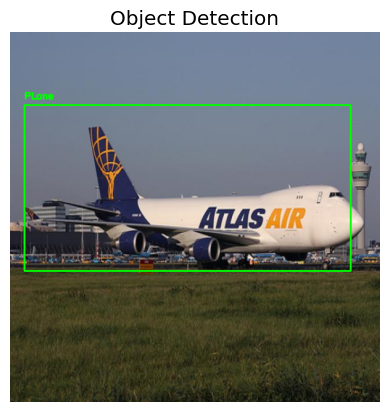

1/1 [==============================] - 0s 26ms/step


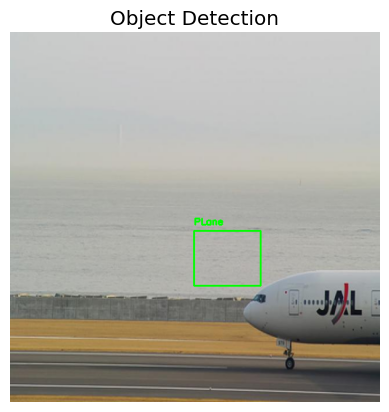

1/1 [==============================] - 0s 26ms/step


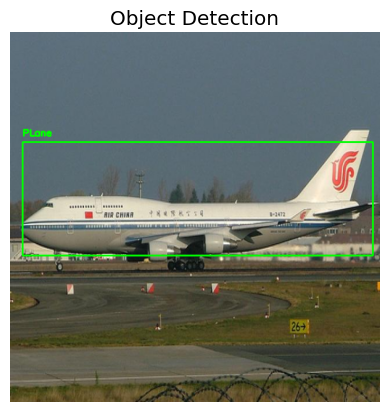

1/1 [==============================] - 0s 30ms/step


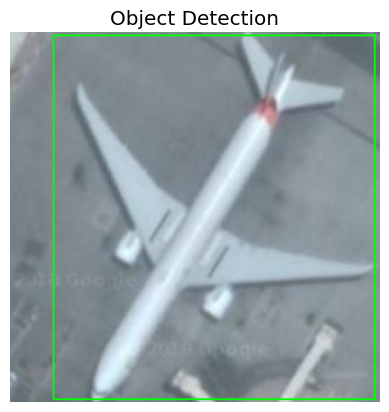

1/1 [==============================] - 0s 38ms/step


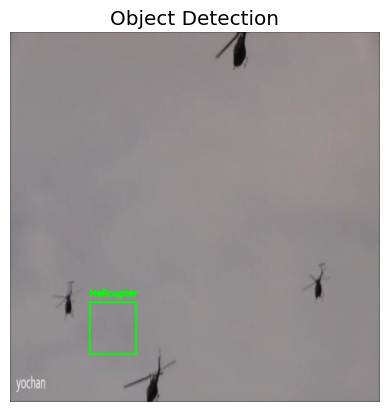

1/1 [==============================] - 0s 29ms/step


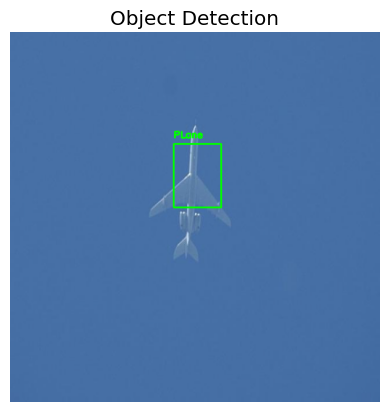

1/1 [==============================] - 0s 25ms/step


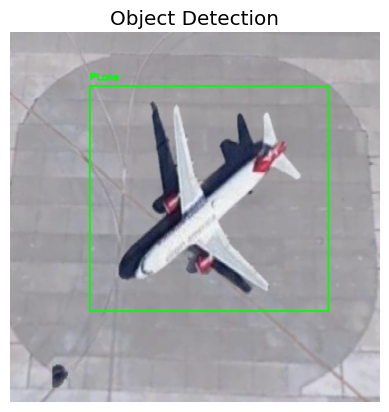

1/1 [==============================] - 0s 28ms/step


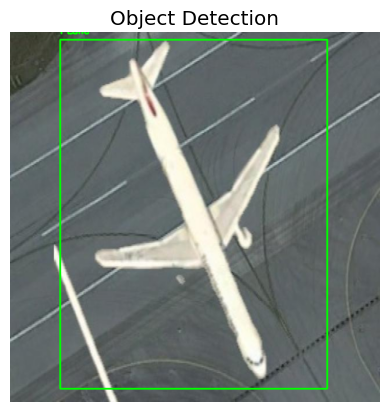

1/1 [==============================] - 0s 27ms/step


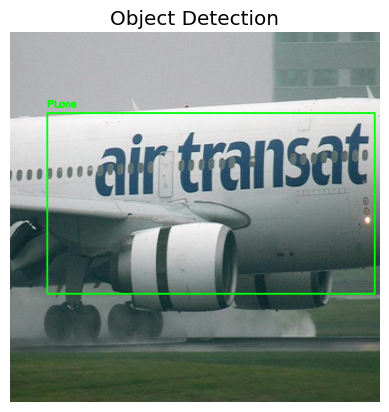

1/1 [==============================] - 0s 25ms/step


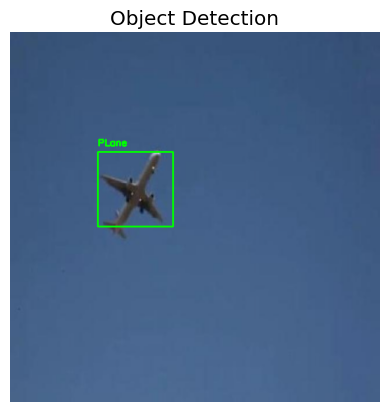

1/1 [==============================] - 0s 27ms/step


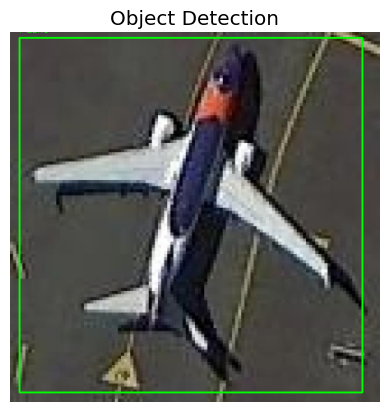

1/1 [==============================] - 0s 27ms/step


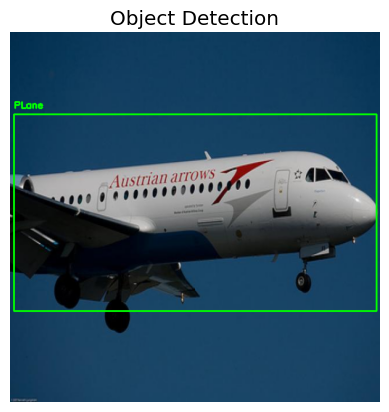

1/1 [==============================] - 0s 30ms/step


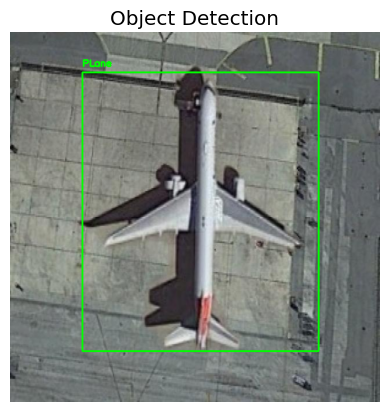

1/1 [==============================] - 0s 27ms/step


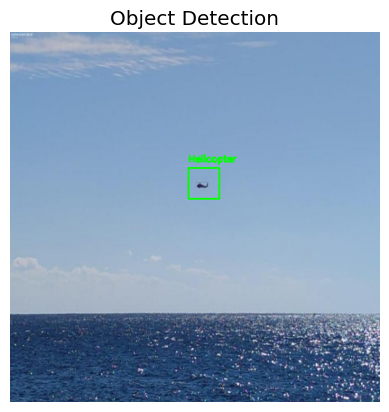

1/1 [==============================] - 0s 26ms/step


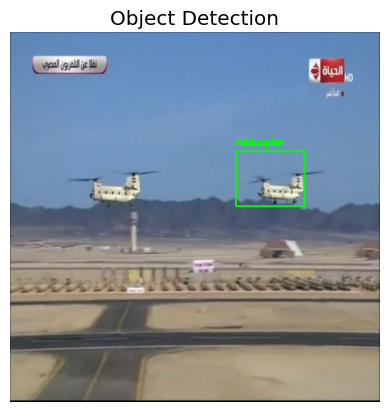

1/1 [==============================] - 0s 26ms/step


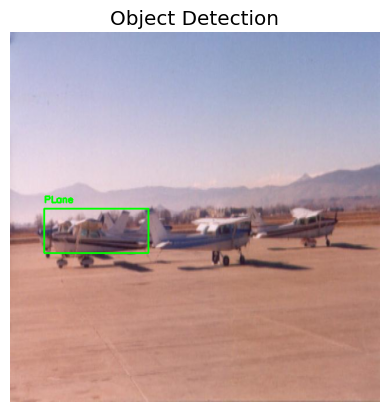

1/1 [==============================] - 0s 27ms/step


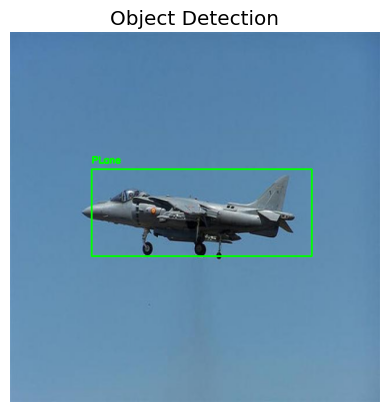

1/1 [==============================] - 0s 26ms/step


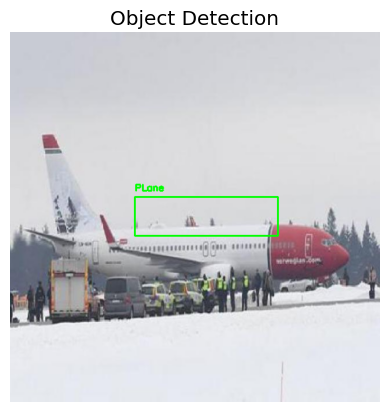

1/1 [==============================] - 0s 28ms/step


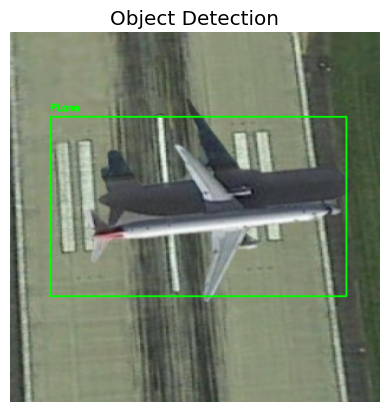

1/1 [==============================] - 0s 27ms/step


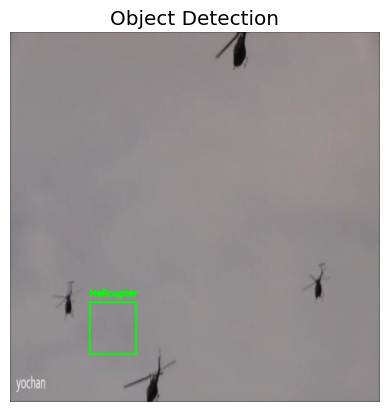

1/1 [==============================] - 0s 27ms/step


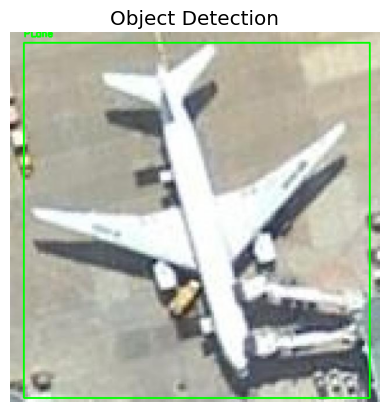

1/1 [==============================] - 0s 26ms/step


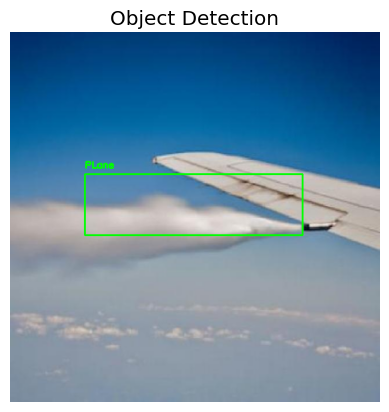

1/1 [==============================] - 0s 25ms/step


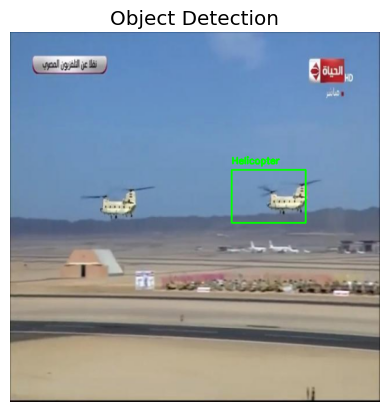

1/1 [==============================] - 0s 25ms/step


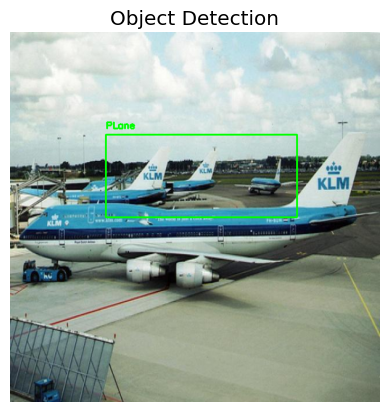

1/1 [==============================] - 0s 29ms/step


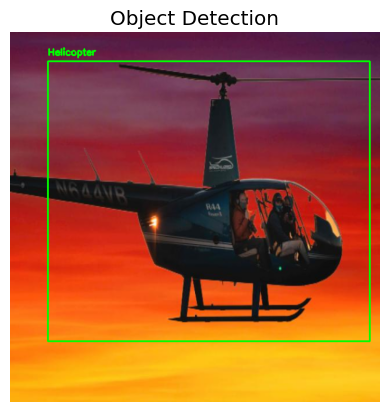

1/1 [==============================] - 0s 31ms/step


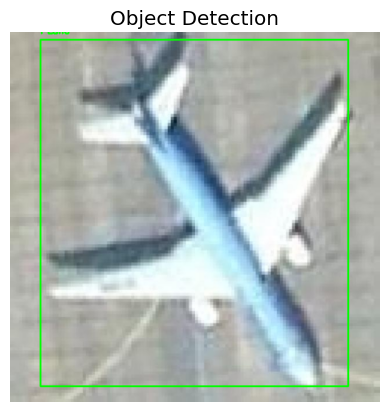

1/1 [==============================] - 0s 35ms/step


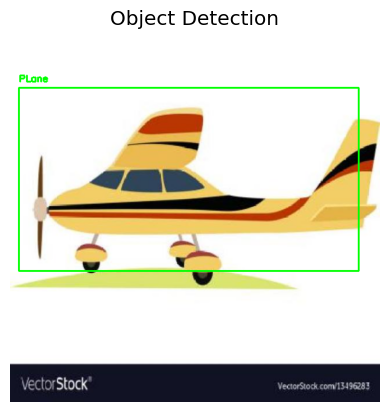

1/1 [==============================] - 0s 37ms/step


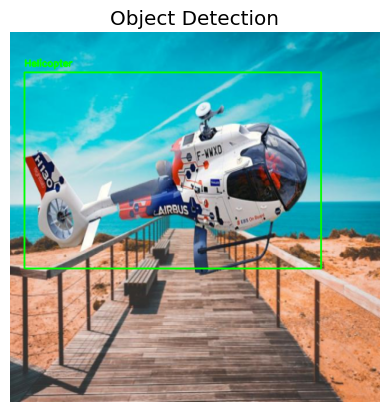

1/1 [==============================] - 0s 33ms/step


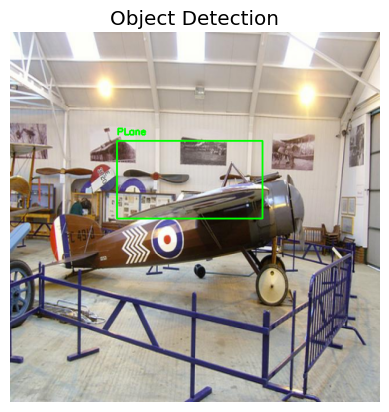

1/1 [==============================] - 0s 35ms/step


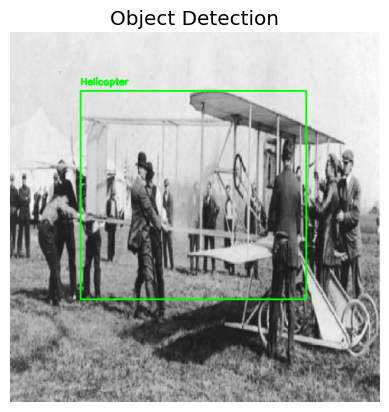

1/1 [==============================] - 0s 32ms/step


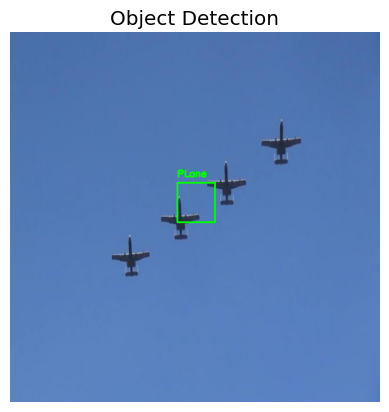

1/1 [==============================] - 0s 28ms/step


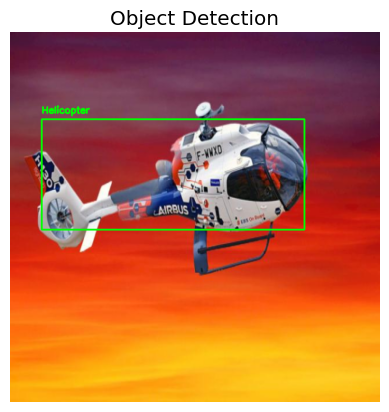

1/1 [==============================] - 0s 29ms/step


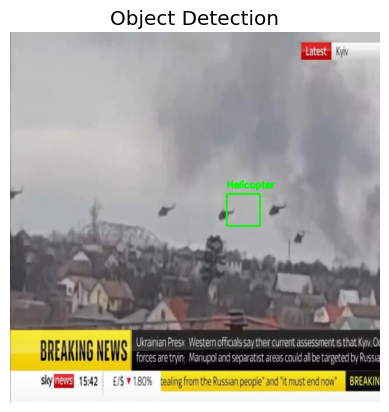

1/1 [==============================] - 0s 34ms/step


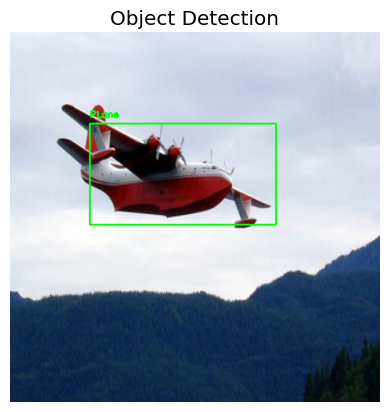

1/1 [==============================] - 0s 33ms/step


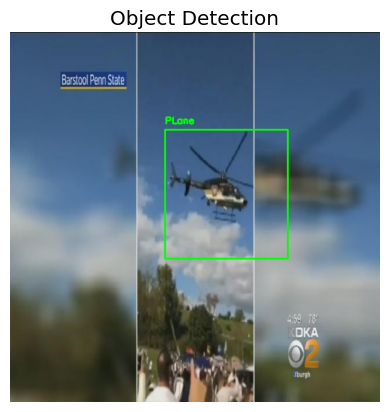

1/1 [==============================] - 0s 48ms/step


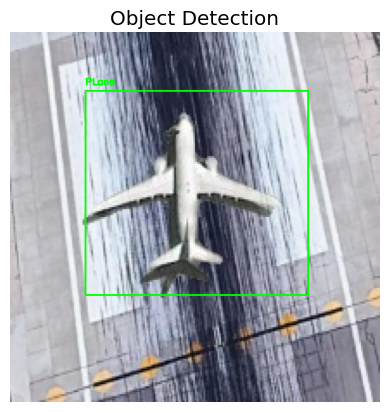

1/1 [==============================] - 0s 33ms/step


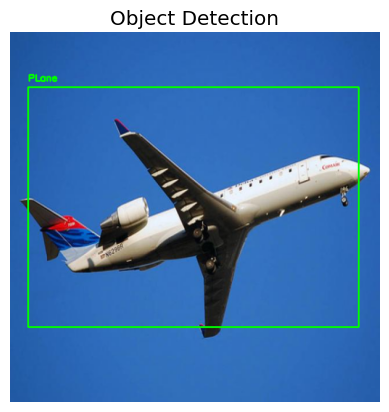

1/1 [==============================] - 0s 37ms/step


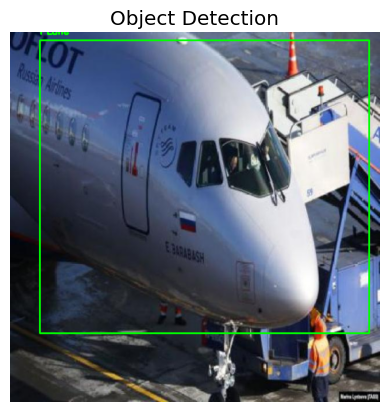

1/1 [==============================] - 0s 30ms/step


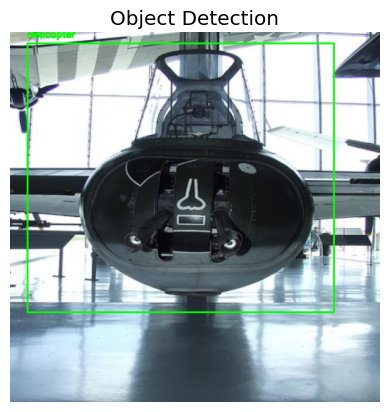

1/1 [==============================] - 0s 33ms/step


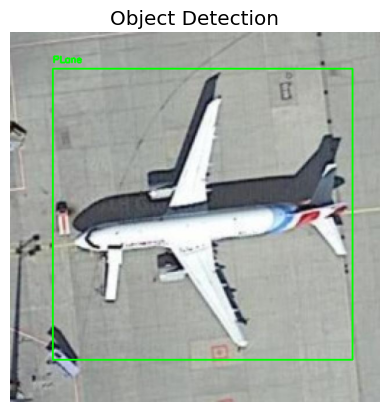

1/1 [==============================] - 0s 30ms/step


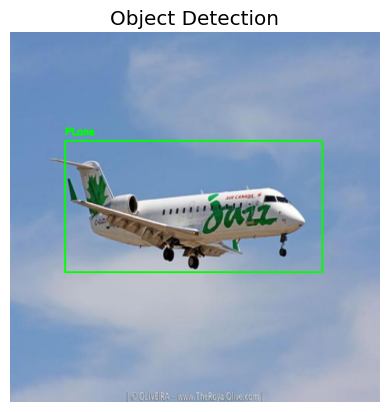

1/1 [==============================] - 0s 30ms/step


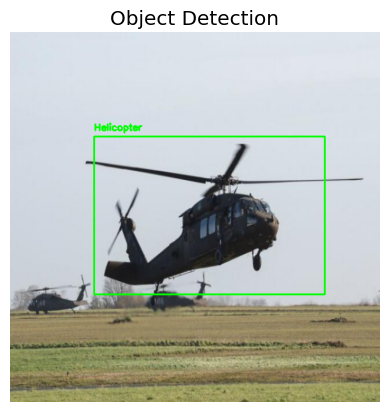

1/1 [==============================] - 0s 28ms/step


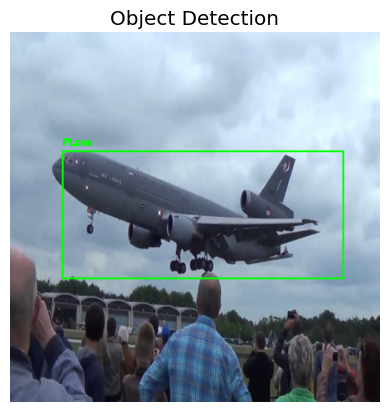

1/1 [==============================] - 0s 27ms/step


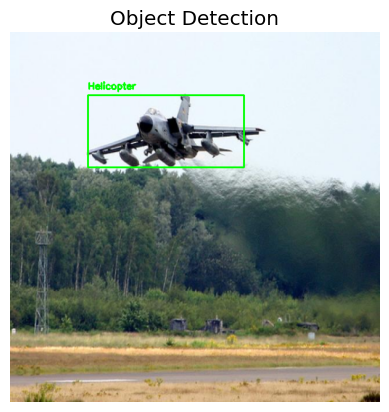

1/1 [==============================] - 0s 28ms/step


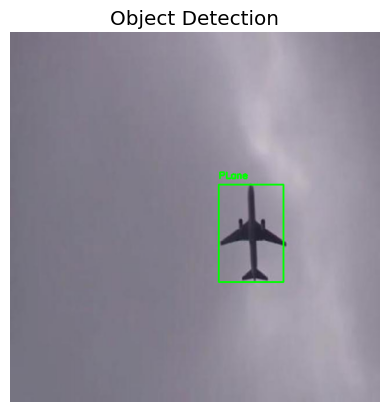

1/1 [==============================] - 0s 27ms/step


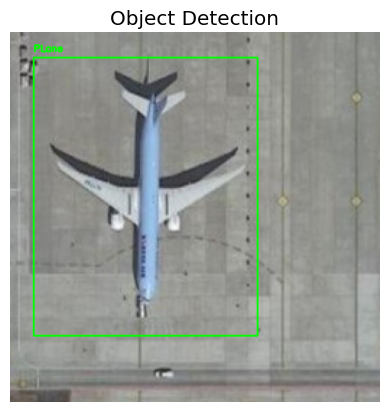

1/1 [==============================] - 0s 28ms/step


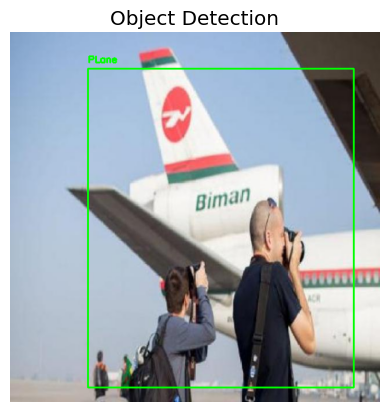

1/1 [==============================] - 0s 27ms/step


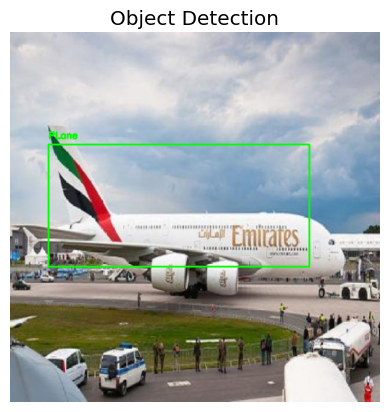

1/1 [==============================] - 0s 30ms/step


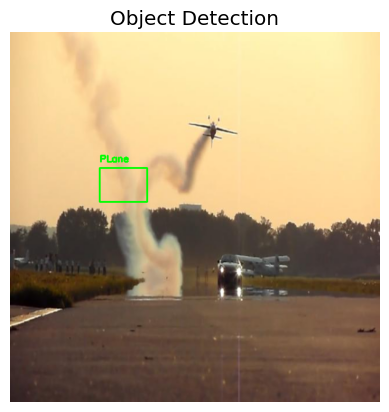

1/1 [==============================] - 0s 27ms/step


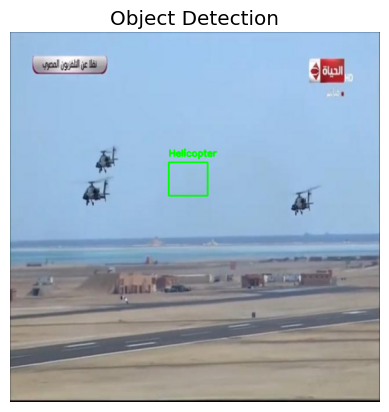

1/1 [==============================] - 0s 28ms/step


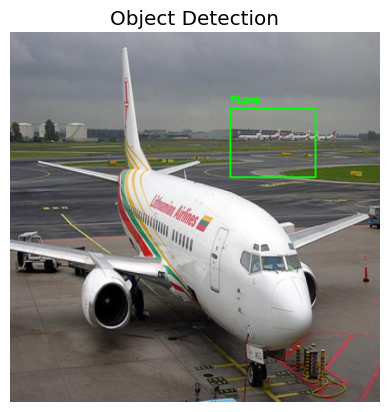

1/1 [==============================] - 0s 30ms/step


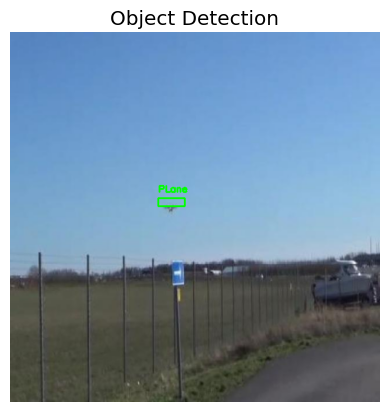

1/1 [==============================] - 0s 28ms/step


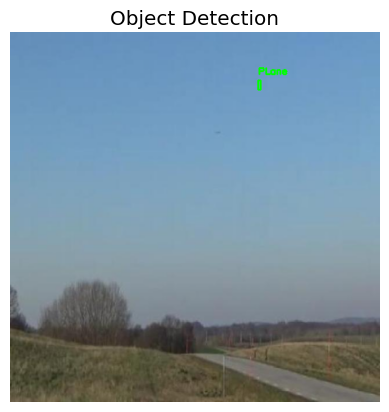

1/1 [==============================] - 0s 27ms/step


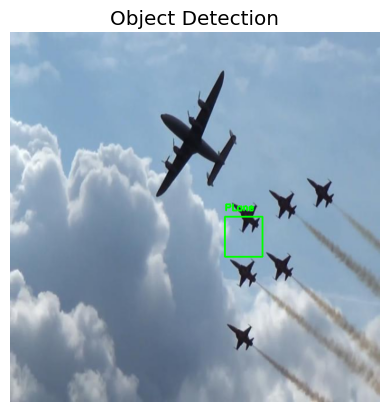

1/1 [==============================] - 0s 30ms/step


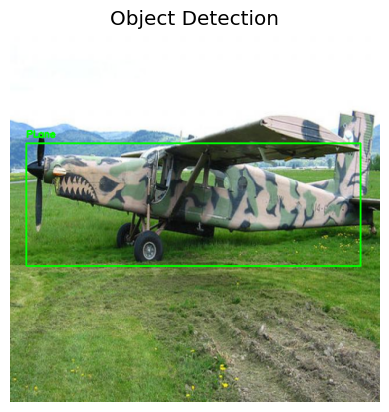

1/1 [==============================] - 0s 27ms/step


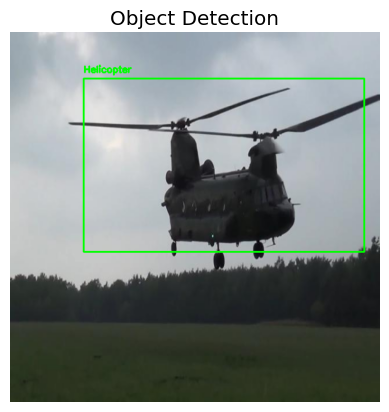

1/1 [==============================] - 0s 27ms/step


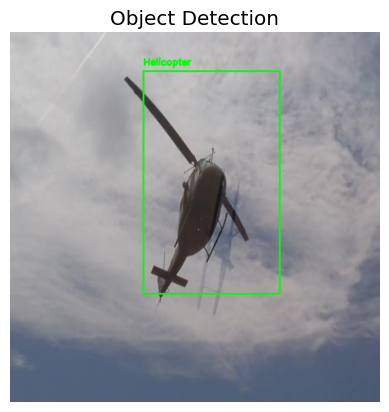

1/1 [==============================] - 0s 26ms/step


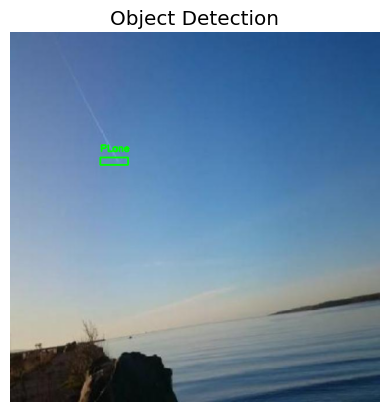

1/1 [==============================] - 0s 26ms/step


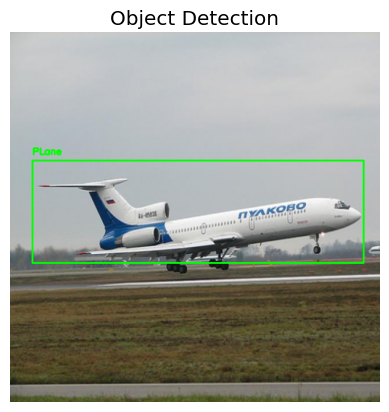

1/1 [==============================] - 0s 27ms/step


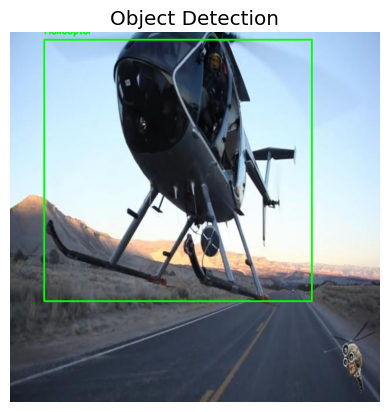

1/1 [==============================] - 0s 26ms/step


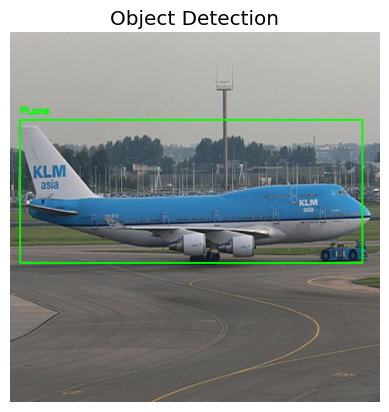

1/1 [==============================] - 0s 26ms/step


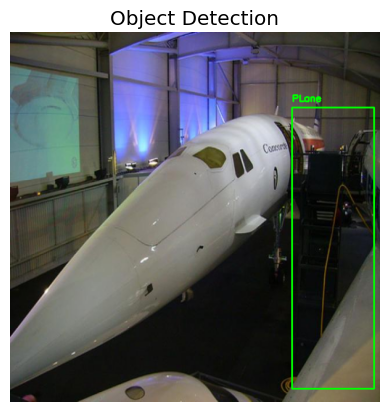

1/1 [==============================] - 0s 32ms/step


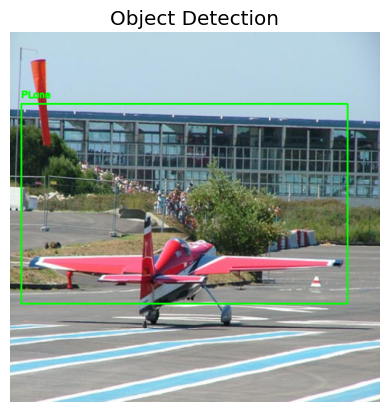

1/1 [==============================] - 0s 51ms/step


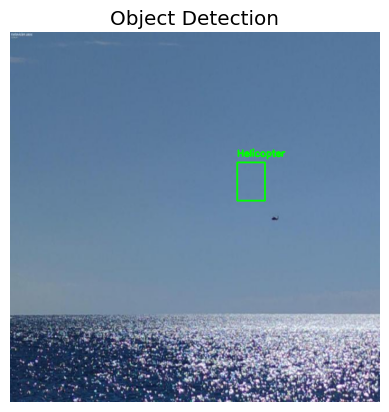

1/1 [==============================] - 0s 33ms/step


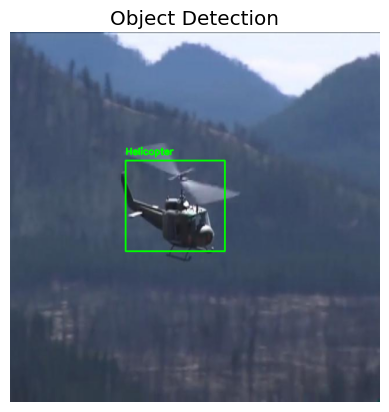

1/1 [==============================] - 0s 26ms/step


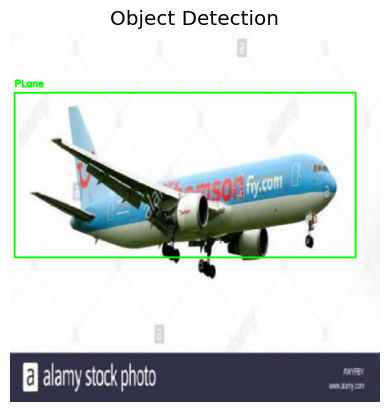

1/1 [==============================] - 0s 43ms/step


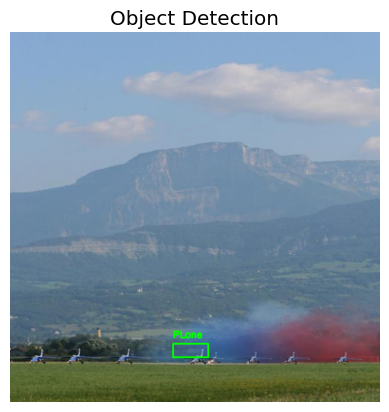

1/1 [==============================] - 0s 50ms/step


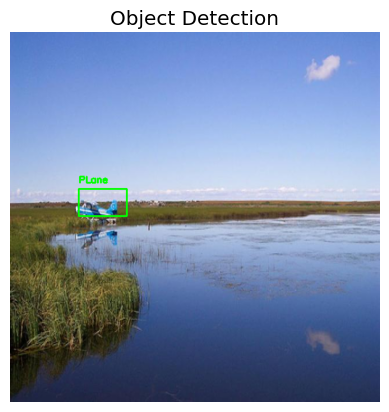

1/1 [==============================] - 0s 46ms/step


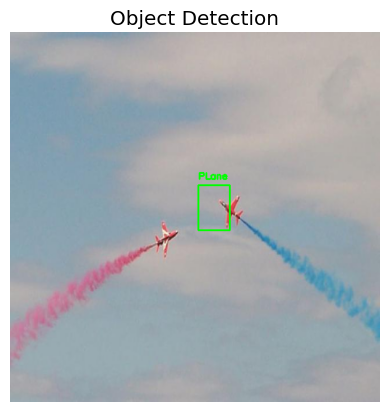

1/1 [==============================] - 0s 35ms/step


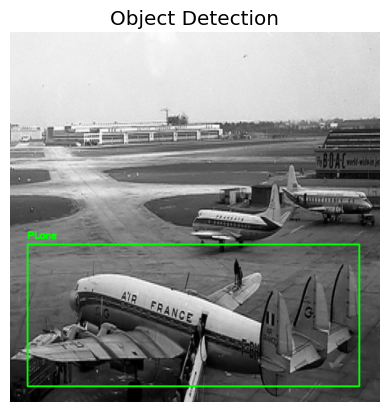

1/1 [==============================] - 0s 39ms/step


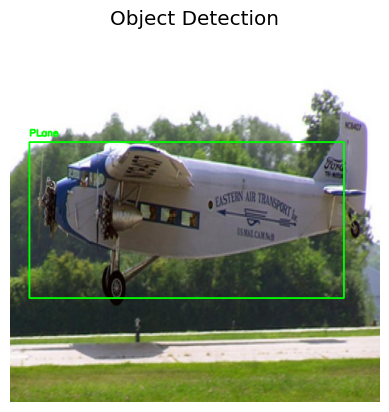

1/1 [==============================] - 0s 55ms/step


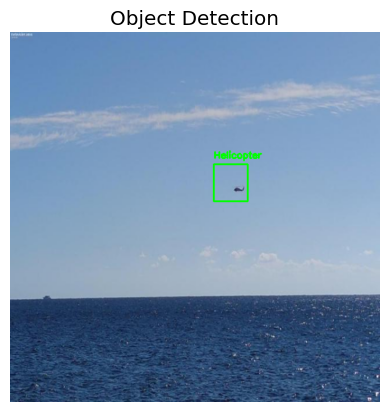

1/1 [==============================] - 0s 27ms/step


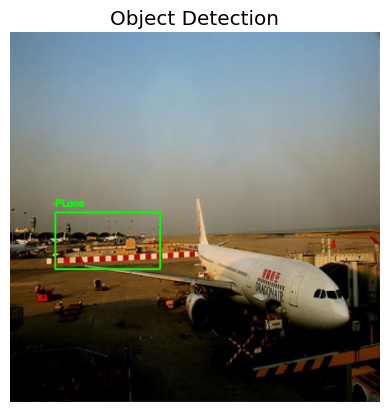

1/1 [==============================] - 0s 55ms/step


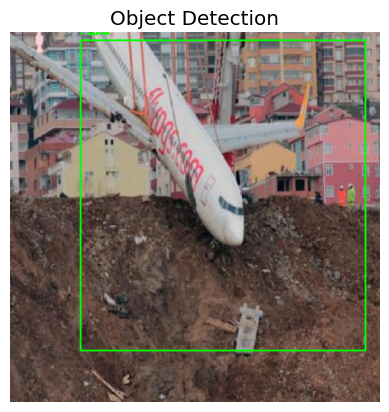

1/1 [==============================] - 0s 54ms/step


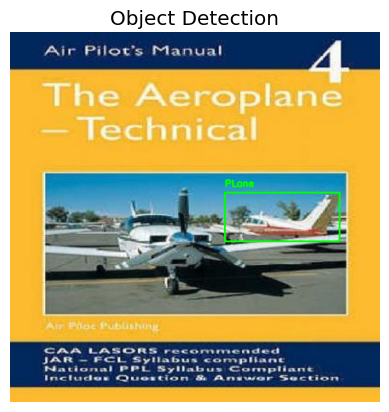

1/1 [==============================] - 0s 38ms/step


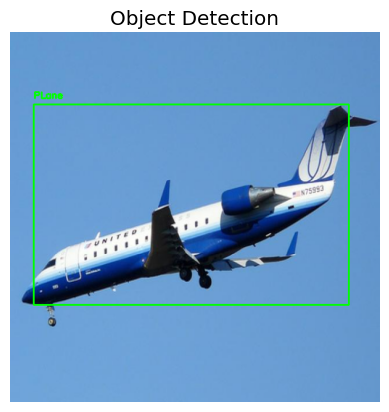

1/1 [==============================] - 0s 31ms/step


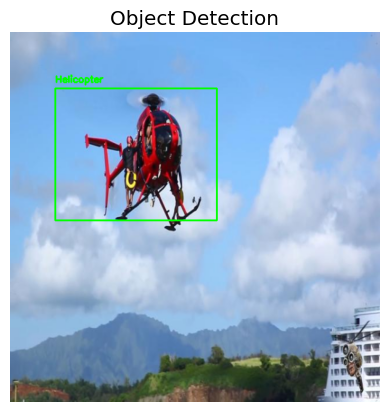

1/1 [==============================] - 0s 26ms/step


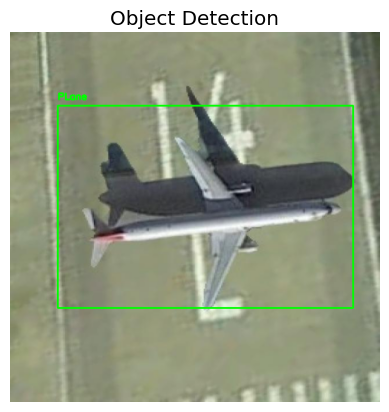

1/1 [==============================] - 0s 25ms/step


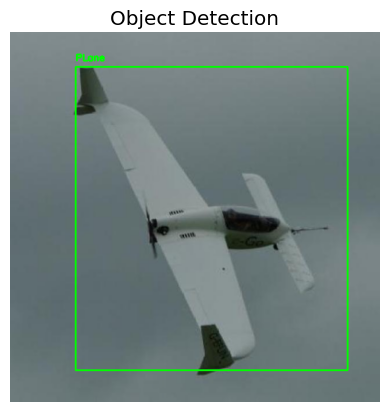

1/1 [==============================] - 0s 29ms/step


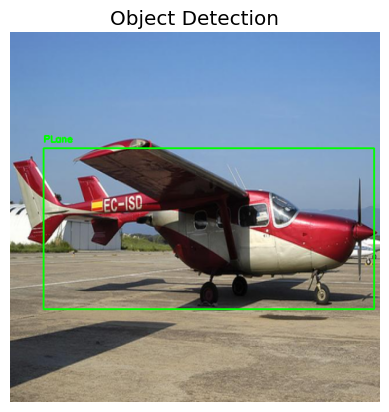

1/1 [==============================] - 0s 26ms/step


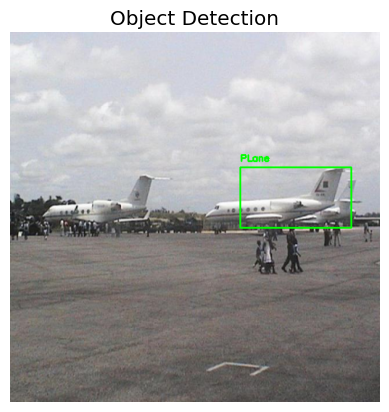

1/1 [==============================] - 0s 26ms/step


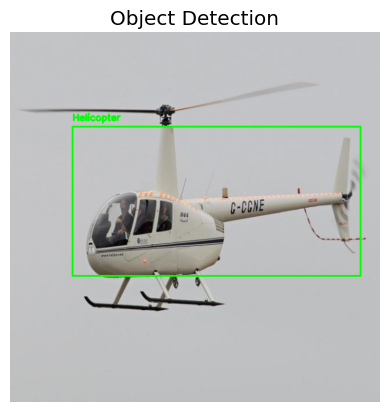

1/1 [==============================] - 0s 26ms/step


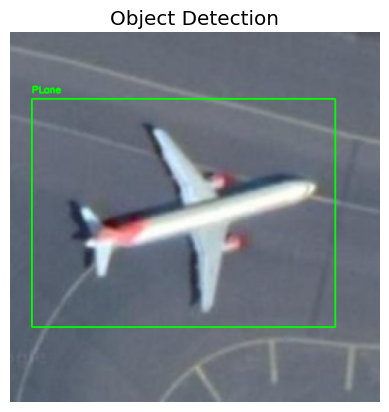

1/1 [==============================] - 0s 26ms/step


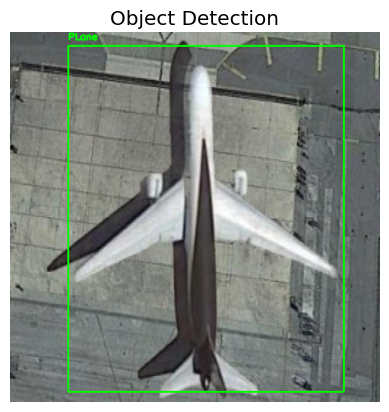

1/1 [==============================] - 0s 26ms/step


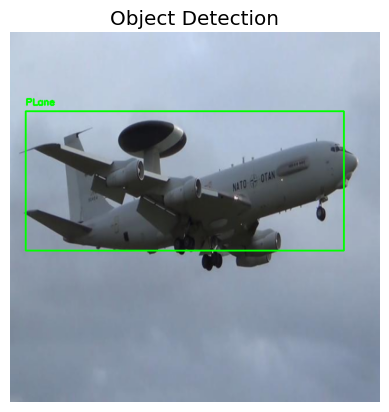

1/1 [==============================] - 0s 26ms/step


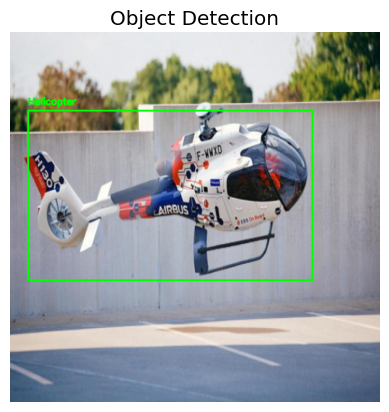

1/1 [==============================] - 0s 25ms/step


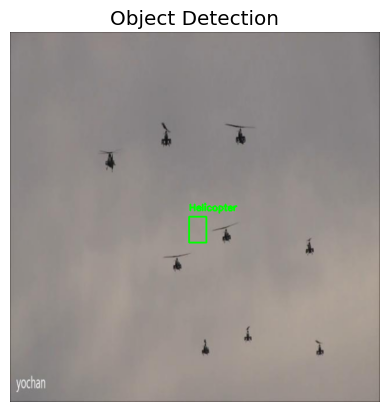

1/1 [==============================] - 0s 26ms/step


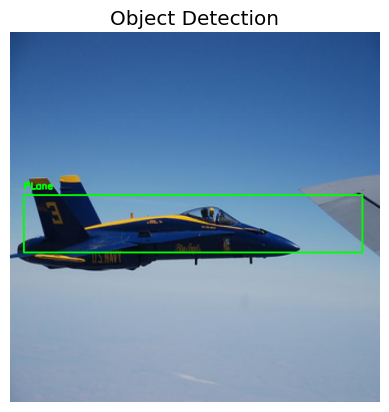

1/1 [==============================] - 0s 26ms/step


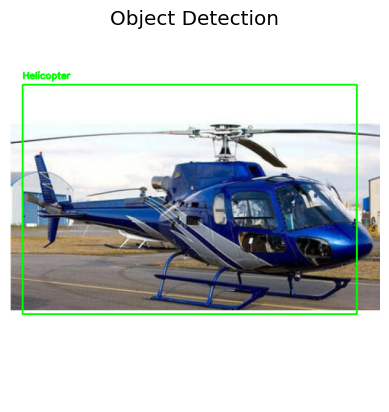

1/1 [==============================] - 0s 36ms/step


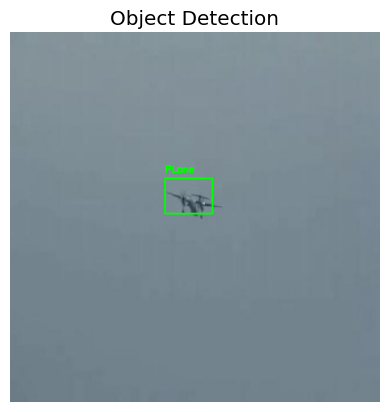

1/1 [==============================] - 0s 28ms/step


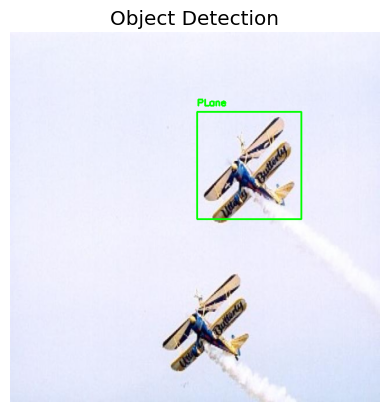

1/1 [==============================] - 0s 27ms/step


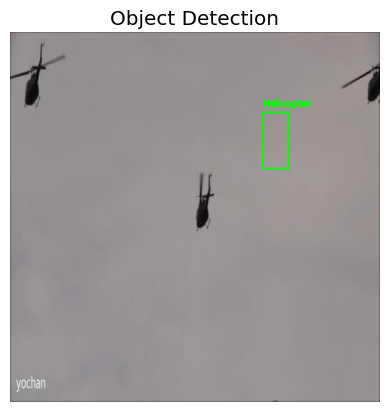

1/1 [==============================] - 0s 27ms/step


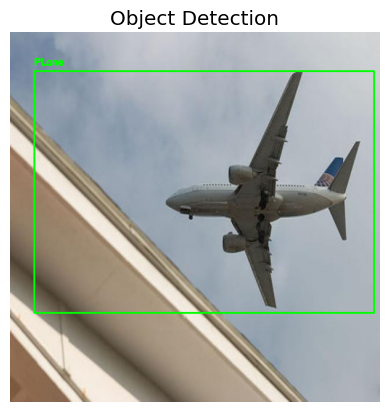

1/1 [==============================] - 0s 26ms/step


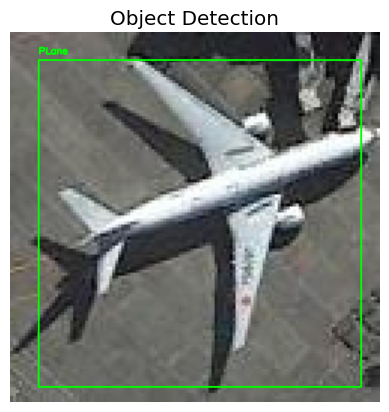

1/1 [==============================] - 0s 34ms/step


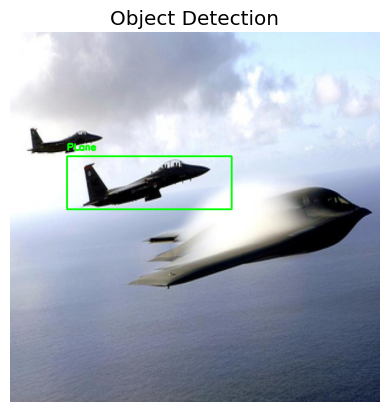

1/1 [==============================] - 0s 28ms/step


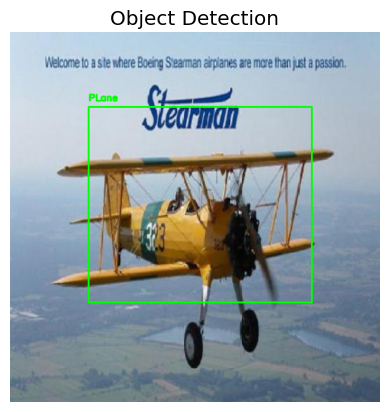

1/1 [==============================] - 0s 26ms/step


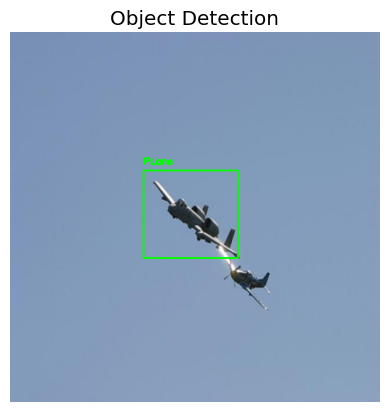

1/1 [==============================] - 0s 27ms/step


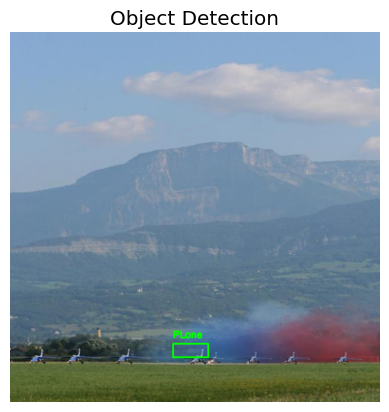

1/1 [==============================] - 0s 26ms/step


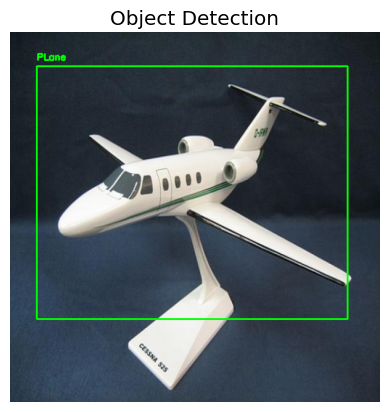

1/1 [==============================] - 0s 26ms/step


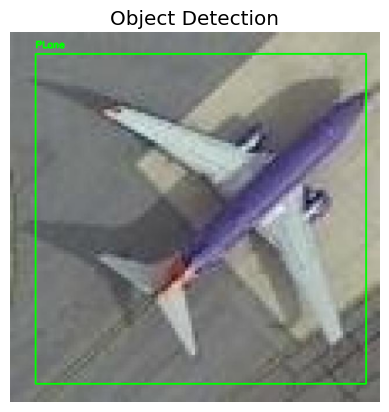

1/1 [==============================] - 0s 26ms/step


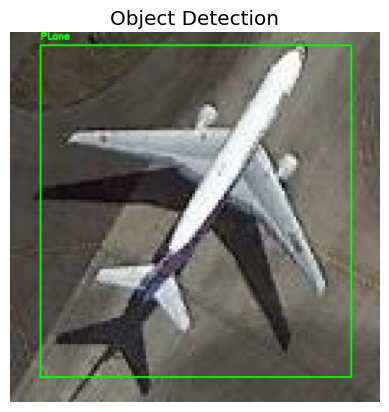

1/1 [==============================] - 0s 26ms/step


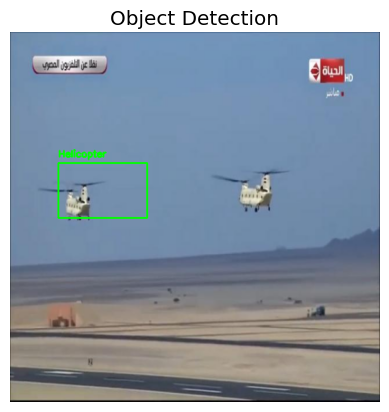

1/1 [==============================] - 0s 26ms/step


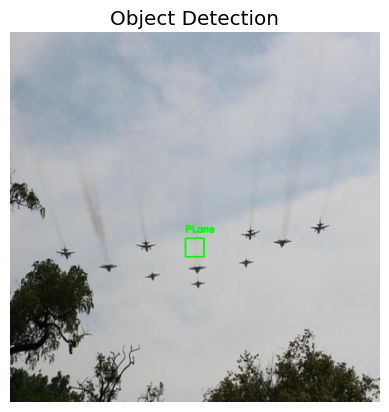

1/1 [==============================] - 0s 33ms/step


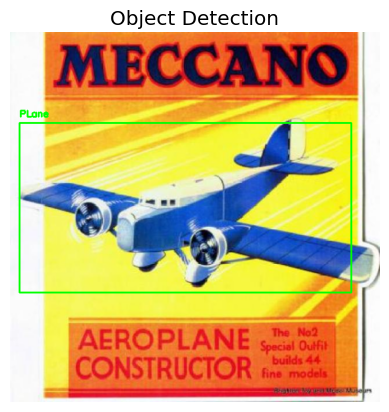

1/1 [==============================] - 0s 54ms/step


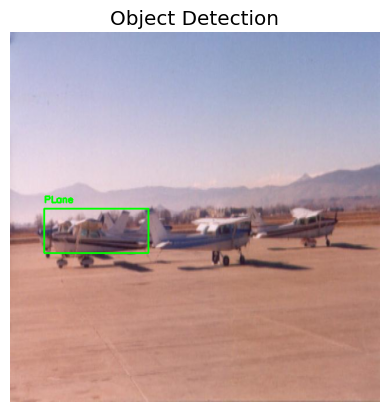

1/1 [==============================] - 0s 39ms/step


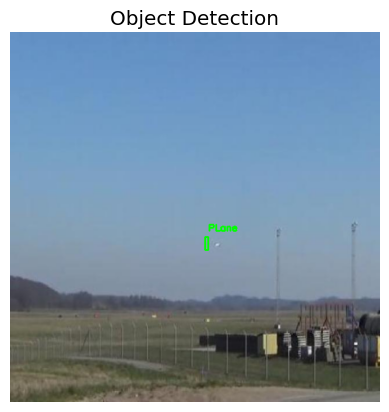

1/1 [==============================] - 0s 26ms/step


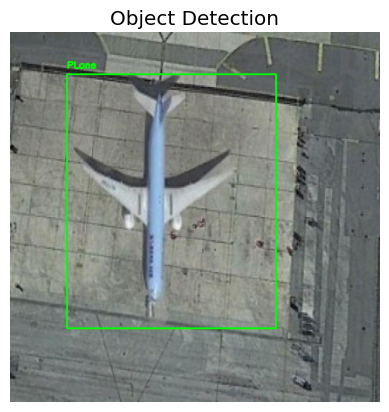

1/1 [==============================] - 0s 56ms/step


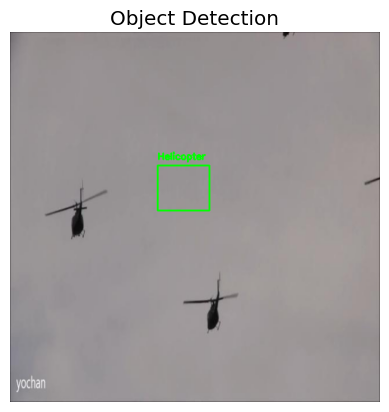

1/1 [==============================] - 0s 46ms/step


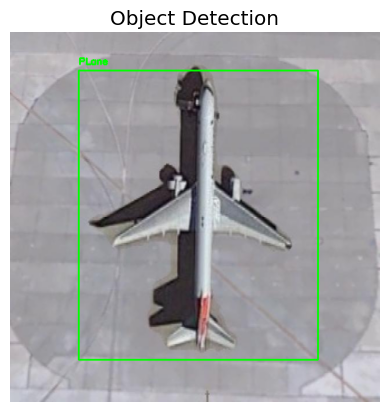

1/1 [==============================] - 0s 35ms/step


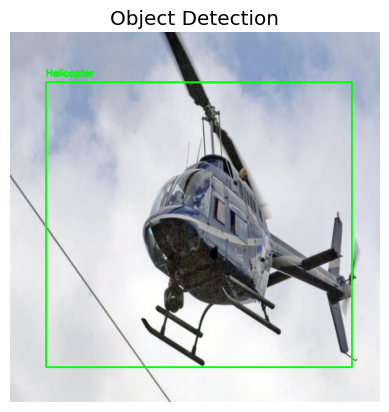

1/1 [==============================] - 0s 41ms/step


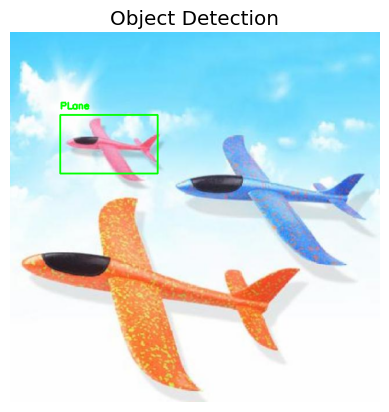

1/1 [==============================] - 0s 48ms/step


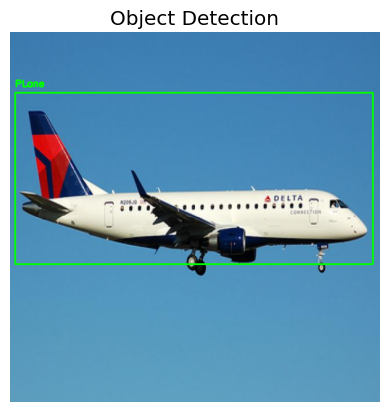

1/1 [==============================] - 0s 41ms/step


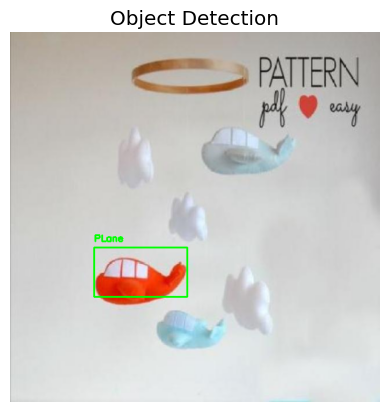

1/1 [==============================] - 0s 42ms/step


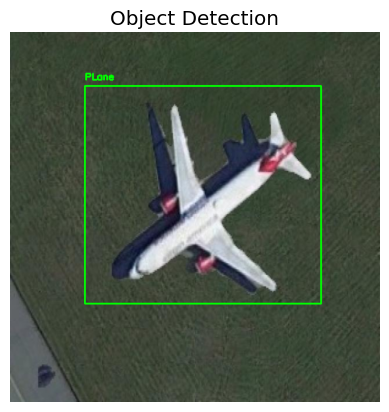

1/1 [==============================] - 0s 38ms/step


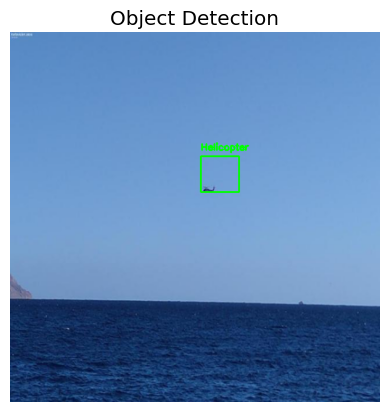

1/1 [==============================] - 0s 41ms/step


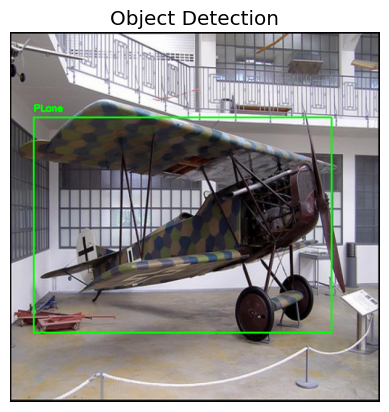

In [ ]:
# Load your trained model for both bounding box and label prediction
print("[INFO] loading object detector...")
model = load_model(config.MODEL_PATH)

# Define class labels for visualization (you should define your class labels)
class_labels = ["Helicopter", "PLane"]

# Loop over the test images
for imagePath in imagePaths:
    # Load and preprocess the input image
    image = load_img(imagePath, target_size=(224, 224))
    image = img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)

    # Make predictions on the input image
    (box_preds, label_preds) = model.predict(image)

    # Loop through the detected objects in the image
    for i in range(box_preds.shape[0]):
        (startX, startY, endX, endY) = box_preds[i]

        # Load the input image in OpenCV format, resize it for visualization, and get its dimensions
        image = cv2.imread(imagePath)
        image = imutils.resize(image, width=600)
        (h, w) = image.shape[:2]

        # Scale the predicted bounding box coordinates based on the image dimensions
        startX = int(startX * w)
        startY = int(startY * h)
        endX = int(endX * w)
        endY = int(endY * h)

        # Get the predicted class label
        label_index = np.argmax(label_preds[i])
        class_label = class_labels[label_index]

        # Draw the predicted bounding box and label on the image
        cv2.rectangle(image, (startX, startY), (endX, endY), (0, 255, 0), 2)
        cv2.putText(image, class_label, (startX, startY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Show the output image with all detected objects using Matplotlib
    plt.figure()
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Object Detection")
    plt.axis('off')
    plt.show()

[INFO] loading object detector...
1/1 [==============================] - 0s 145ms/step


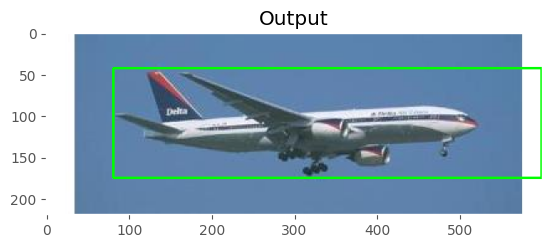

1/1 [==============================] - 0s 20ms/step


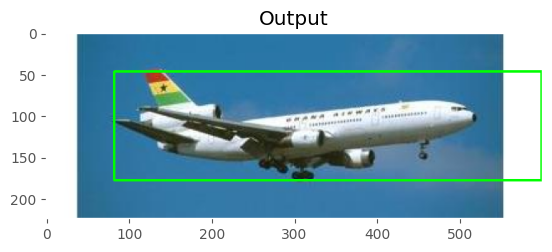

1/1 [==============================] - 0s 18ms/step


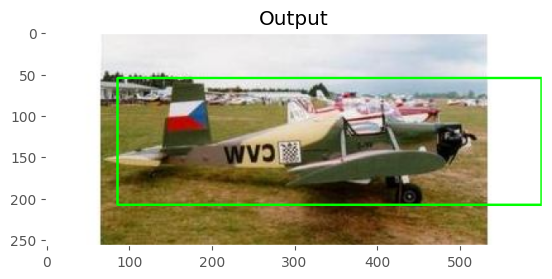

1/1 [==============================] - 0s 24ms/step


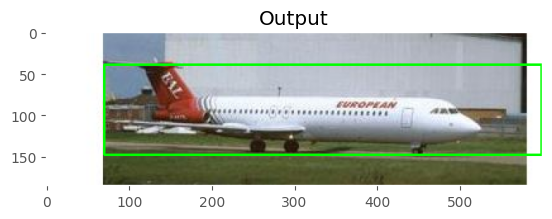

1/1 [==============================] - 0s 19ms/step


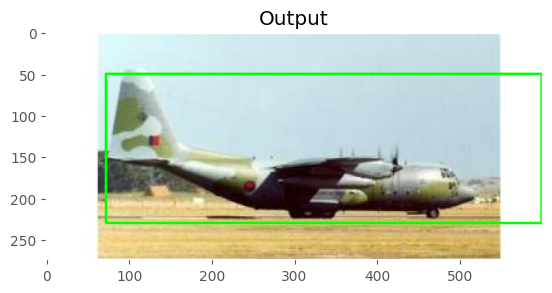

1/1 [==============================] - 0s 18ms/step


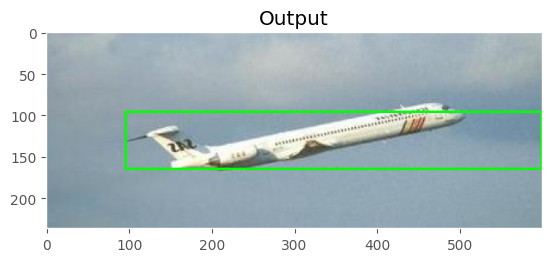

1/1 [==============================] - 0s 18ms/step


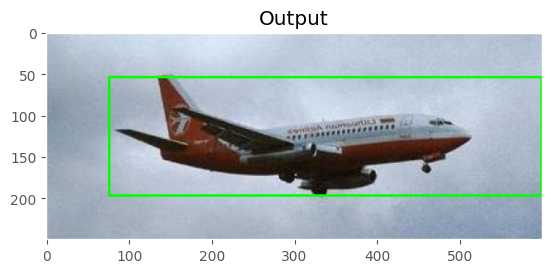

1/1 [==============================] - 0s 19ms/step


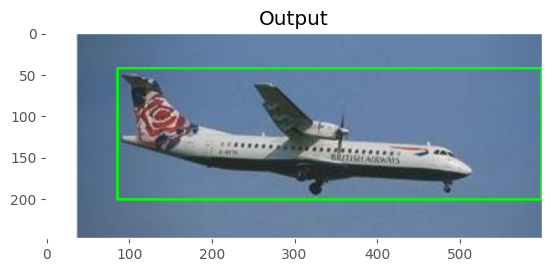

1/1 [==============================] - 0s 28ms/step


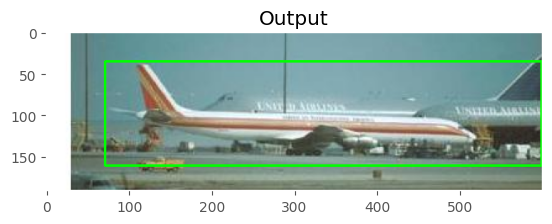

1/1 [==============================] - 0s 18ms/step


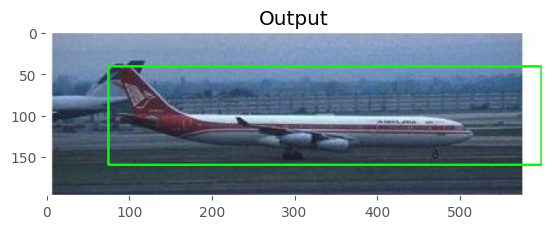

1/1 [==============================] - 0s 20ms/step


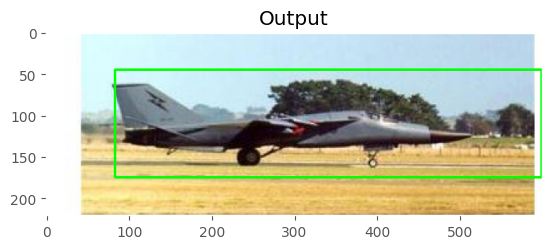

1/1 [==============================] - 0s 19ms/step


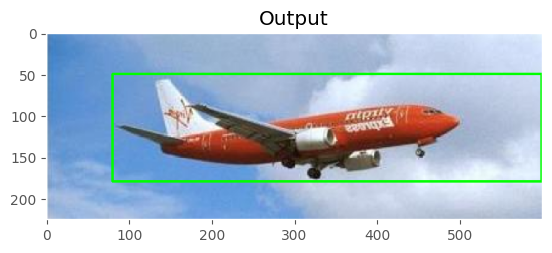

1/1 [==============================] - 0s 23ms/step


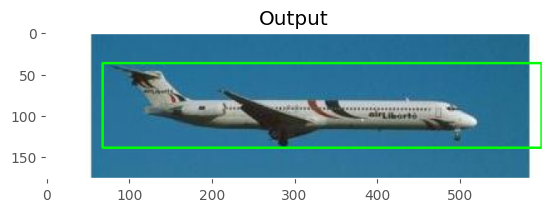

1/1 [==============================] - 0s 18ms/step


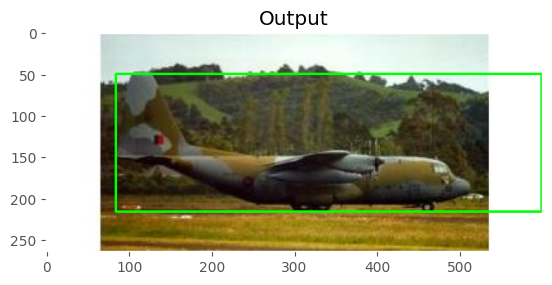

1/1 [==============================] - 0s 37ms/step


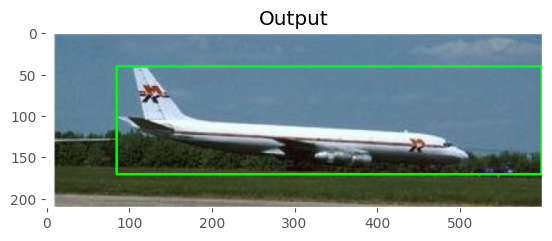

1/1 [==============================] - 0s 54ms/step


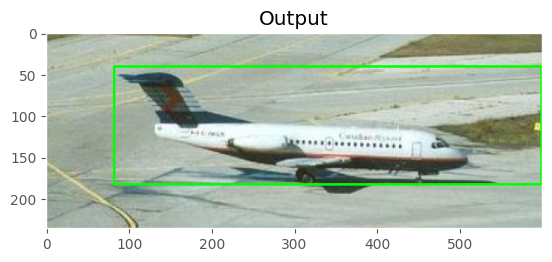

1/1 [==============================] - 0s 29ms/step


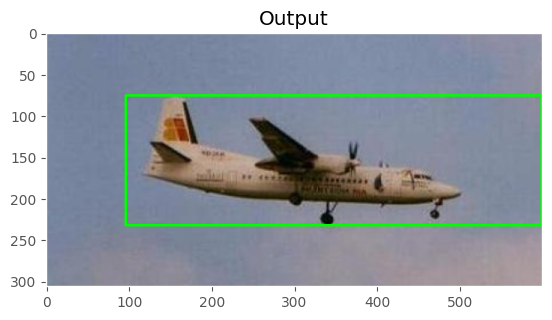

1/1 [==============================] - 0s 63ms/step


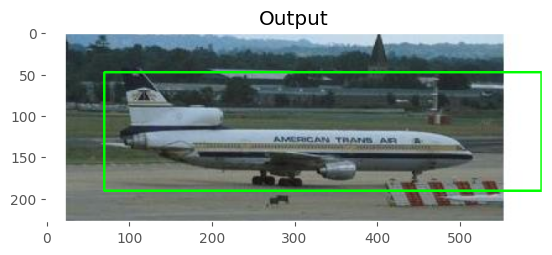

1/1 [==============================] - 0s 26ms/step


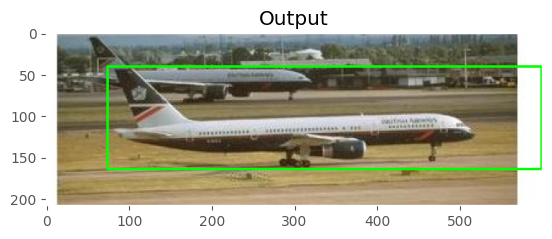

1/1 [==============================] - 0s 28ms/step


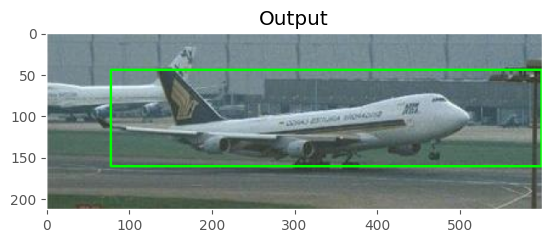

1/1 [==============================] - 0s 26ms/step


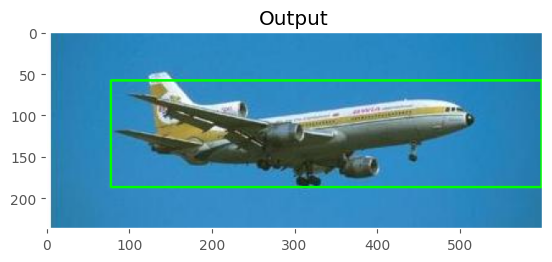

1/1 [==============================] - 0s 26ms/step


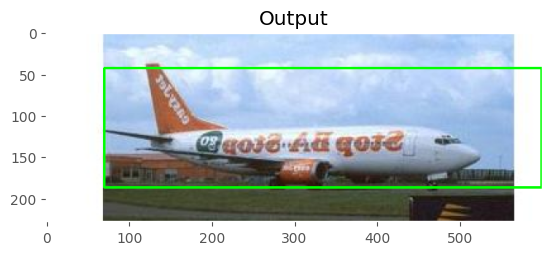

1/1 [==============================] - 0s 52ms/step


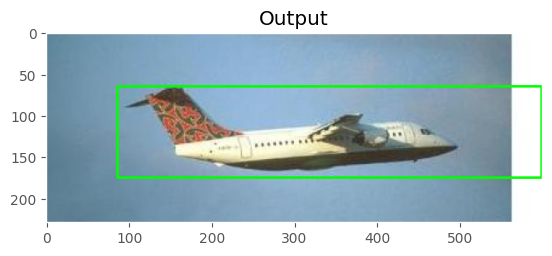

1/1 [==============================] - 0s 21ms/step


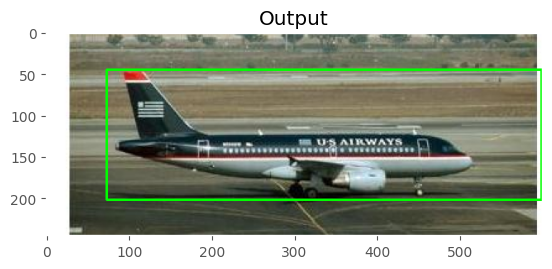

1/1 [==============================] - 0s 38ms/step


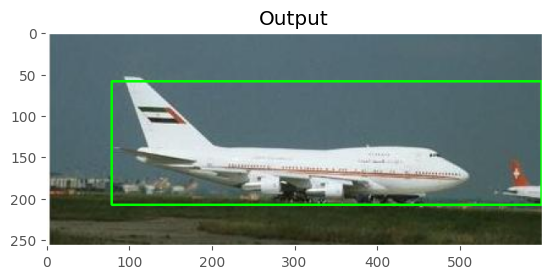

1/1 [==============================] - 0s 20ms/step


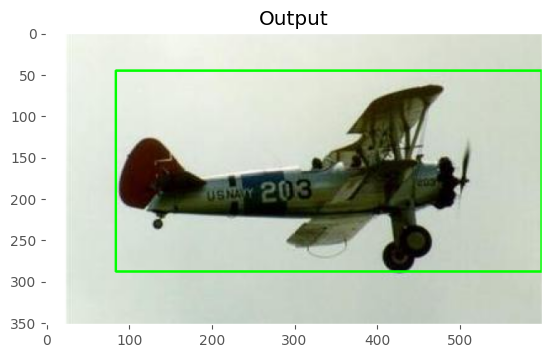

1/1 [==============================] - 0s 33ms/step


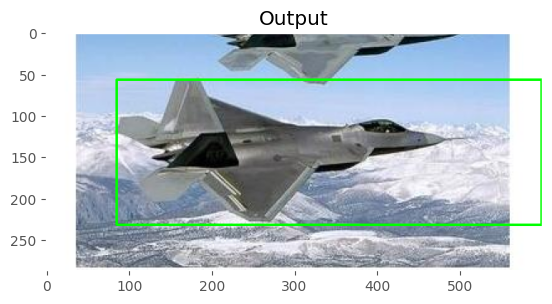

1/1 [==============================] - 0s 26ms/step


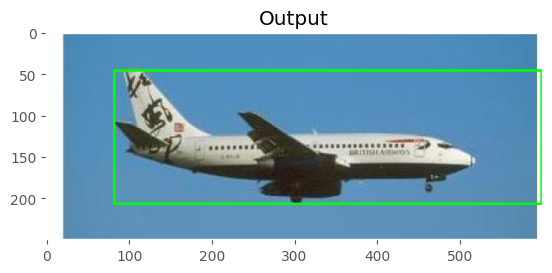

1/1 [==============================] - 0s 25ms/step


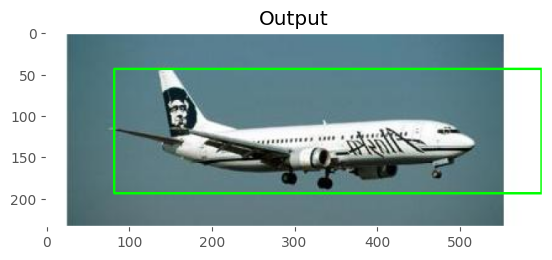

1/1 [==============================] - 0s 24ms/step


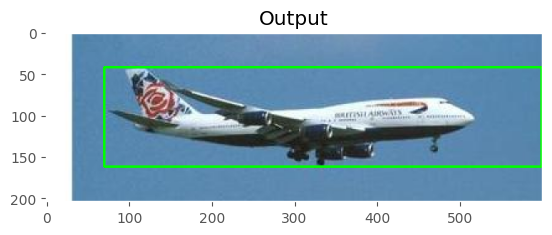

1/1 [==============================] - 0s 38ms/step


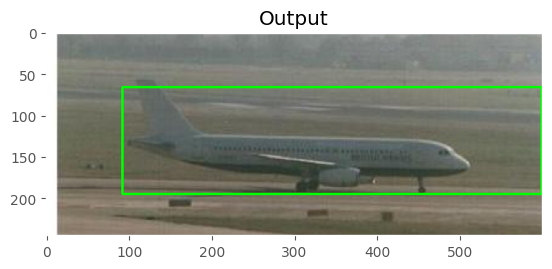

1/1 [==============================] - 0s 27ms/step


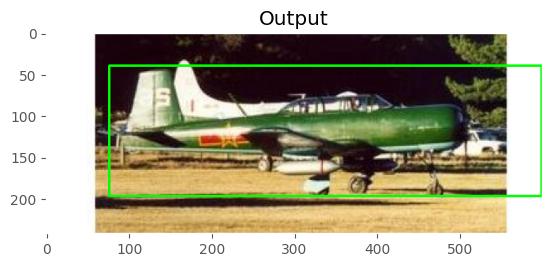

1/1 [==============================] - 0s 27ms/step


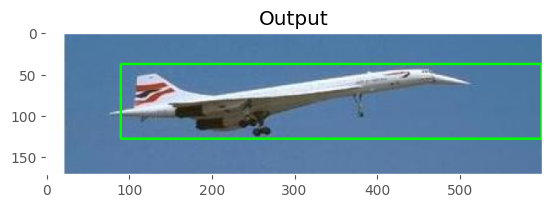

1/1 [==============================] - 0s 26ms/step


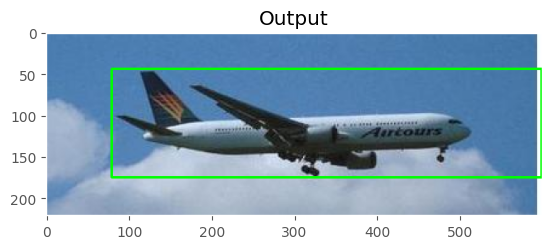

1/1 [==============================] - 0s 28ms/step


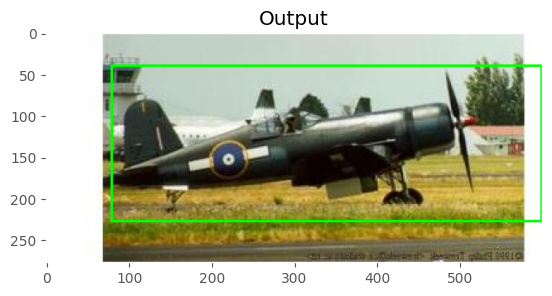

1/1 [==============================] - 0s 25ms/step


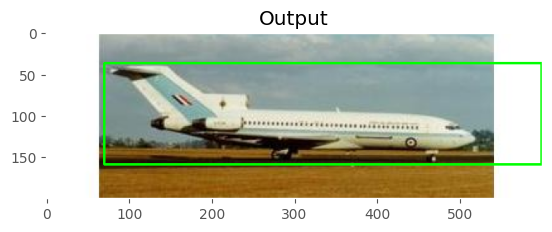

1/1 [==============================] - 0s 27ms/step


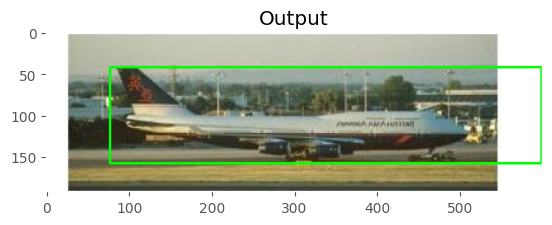

1/1 [==============================] - 0s 29ms/step


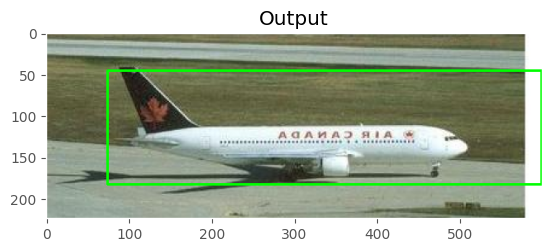

1/1 [==============================] - 0s 27ms/step


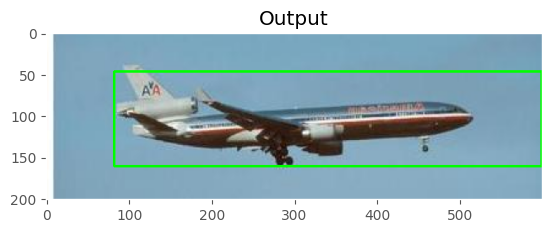

1/1 [==============================] - 0s 43ms/step


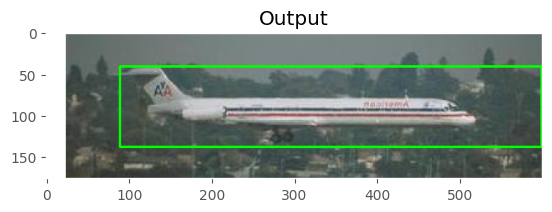

1/1 [==============================] - 0s 26ms/step


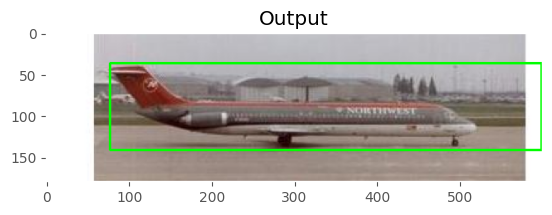

1/1 [==============================] - 0s 28ms/step


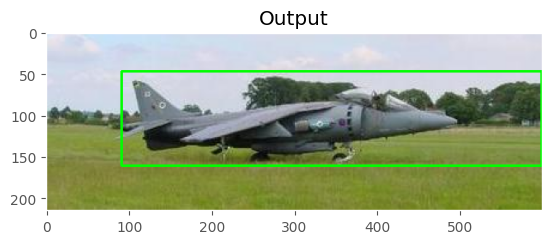

1/1 [==============================] - 0s 27ms/step


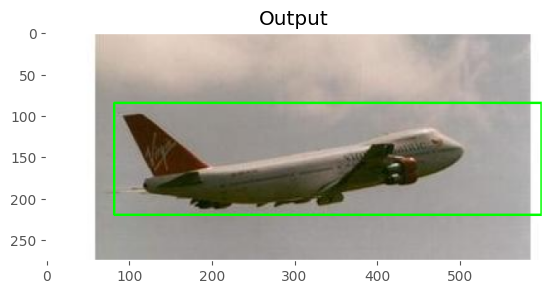

1/1 [==============================] - 0s 29ms/step


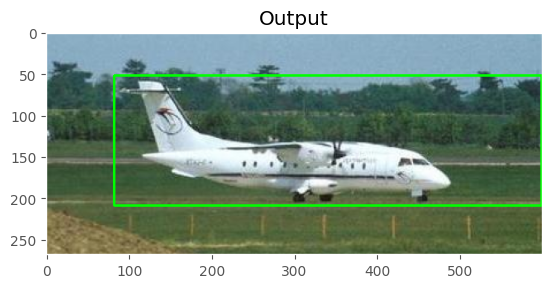

1/1 [==============================] - 0s 28ms/step


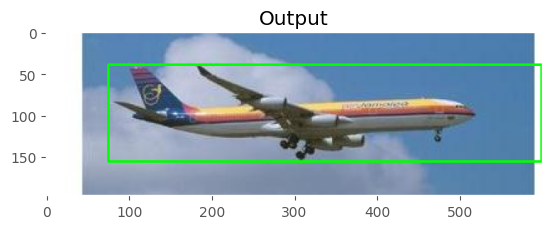

1/1 [==============================] - 0s 29ms/step


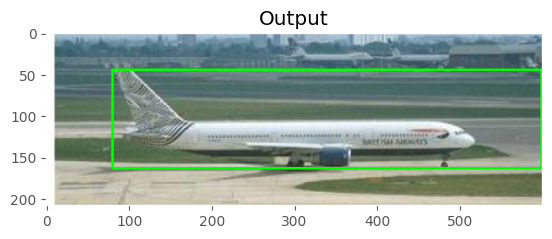

1/1 [==============================] - 0s 26ms/step


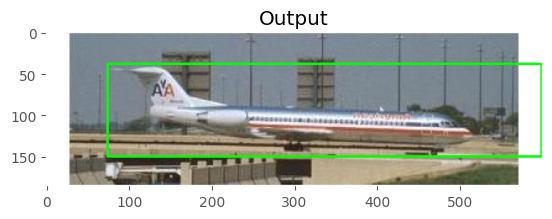

1/1 [==============================] - 0s 33ms/step


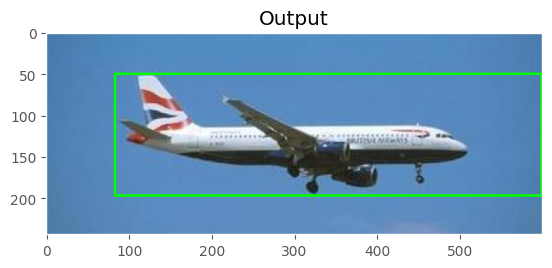

1/1 [==============================] - 0s 45ms/step


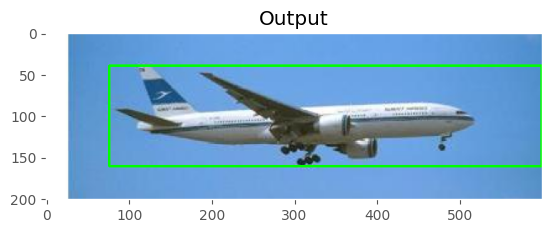

1/1 [==============================] - 0s 27ms/step


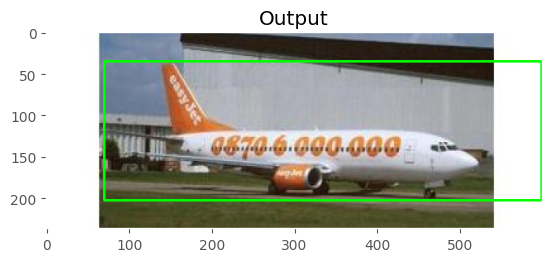

1/1 [==============================] - 0s 32ms/step


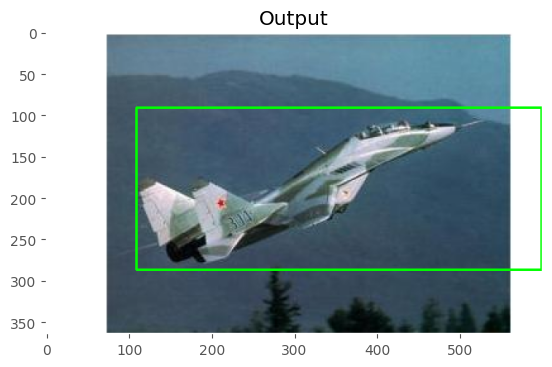

1/1 [==============================] - 0s 35ms/step


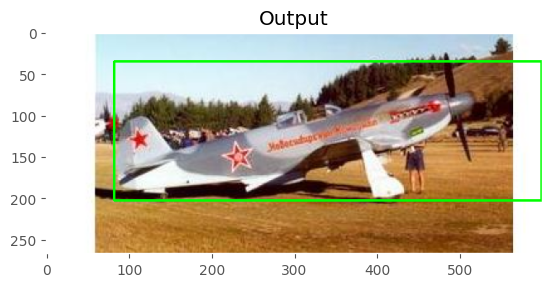

1/1 [==============================] - 0s 36ms/step


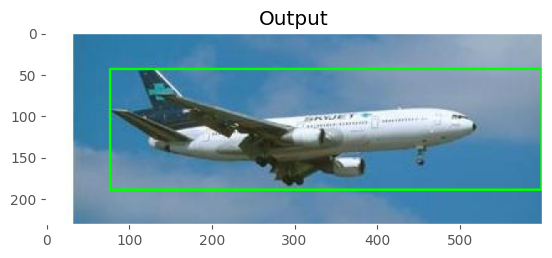

1/1 [==============================] - 0s 33ms/step


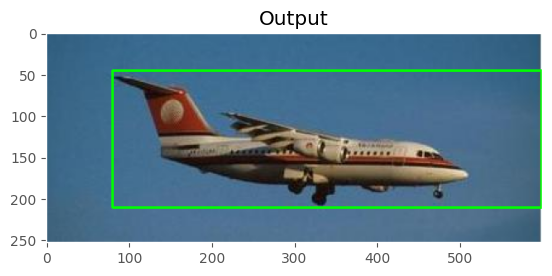

1/1 [==============================] - 0s 41ms/step


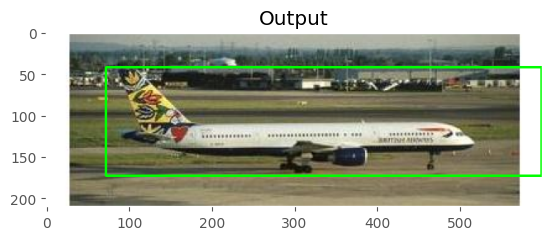

1/1 [==============================] - 0s 36ms/step


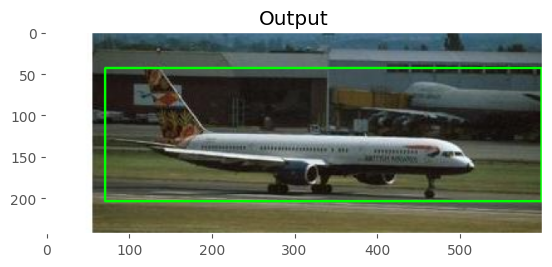

1/1 [==============================] - 0s 35ms/step


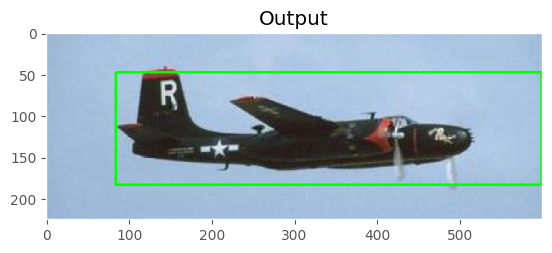

1/1 [==============================] - 0s 31ms/step


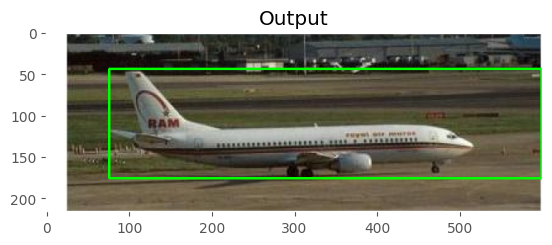

1/1 [==============================] - 0s 32ms/step


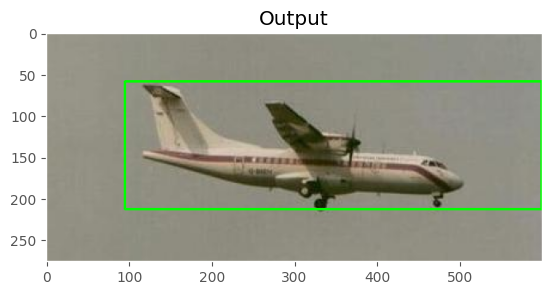

1/1 [==============================] - 0s 31ms/step


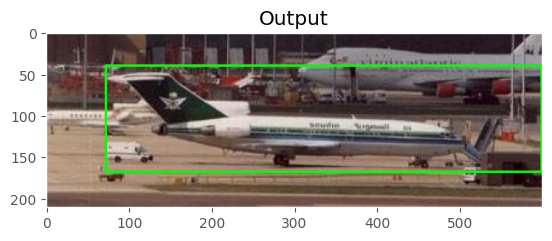

1/1 [==============================] - 0s 34ms/step


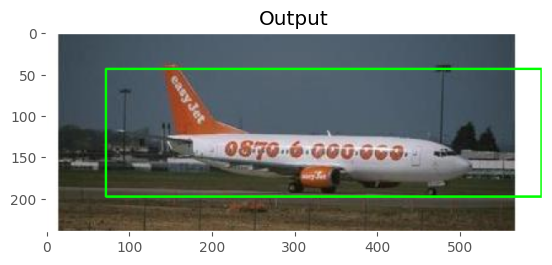

1/1 [==============================] - 0s 61ms/step


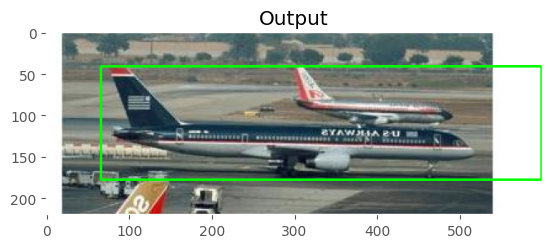

1/1 [==============================] - 0s 27ms/step


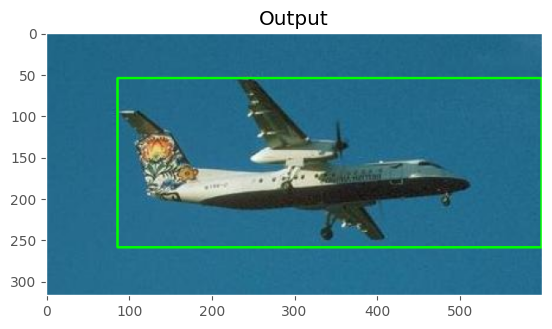

1/1 [==============================] - 0s 35ms/step


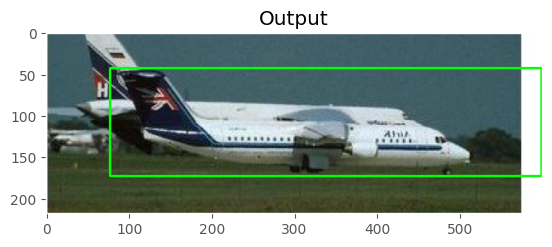

1/1 [==============================] - 0s 27ms/step


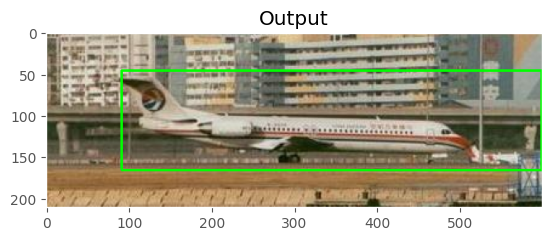

1/1 [==============================] - 0s 26ms/step


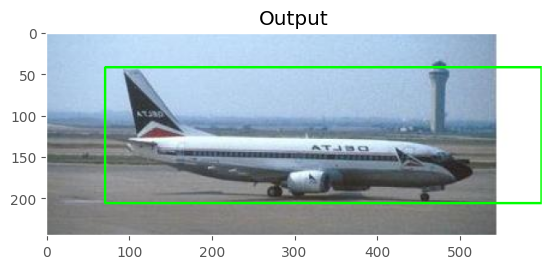

1/1 [==============================] - 0s 26ms/step


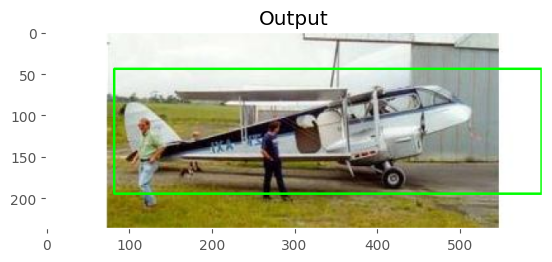

1/1 [==============================] - 0s 25ms/step


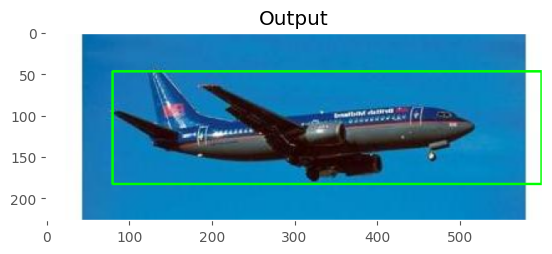

1/1 [==============================] - 0s 25ms/step


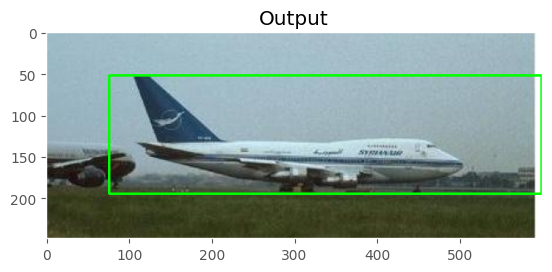

1/1 [==============================] - 0s 28ms/step


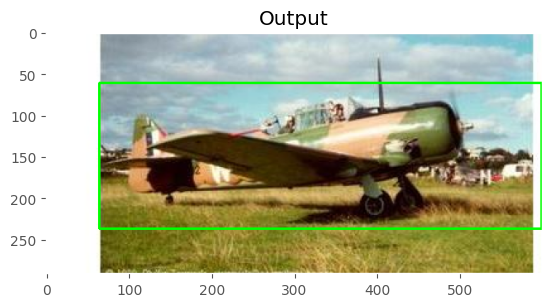

1/1 [==============================] - 0s 25ms/step


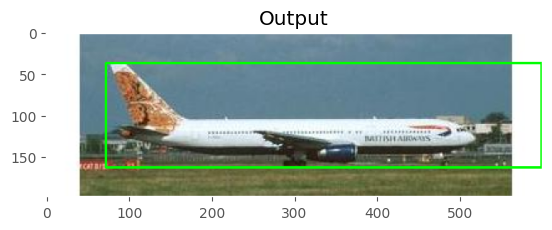

1/1 [==============================] - 0s 26ms/step


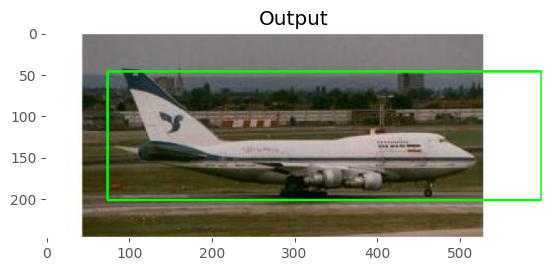

1/1 [==============================] - 0s 25ms/step


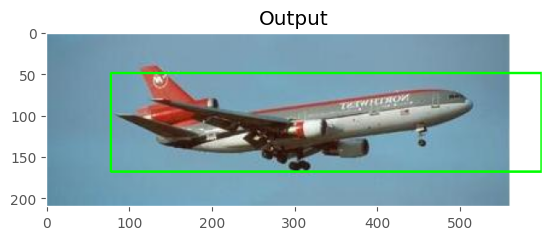

1/1 [==============================] - 0s 25ms/step


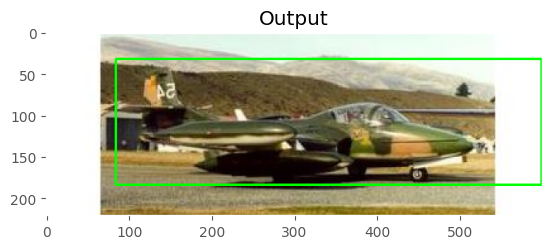

1/1 [==============================] - 0s 26ms/step


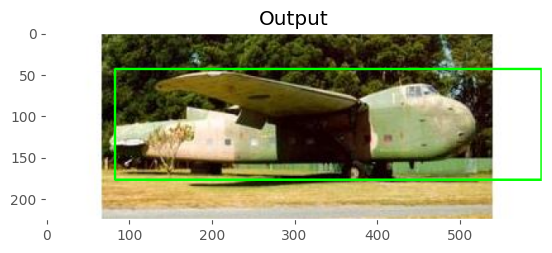

1/1 [==============================] - 0s 26ms/step


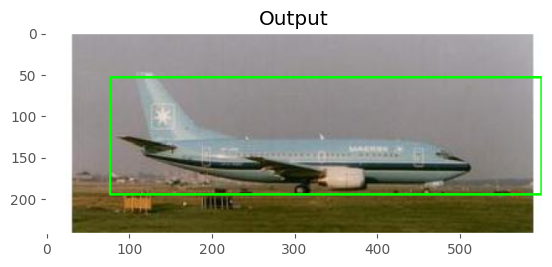

1/1 [==============================] - 0s 34ms/step


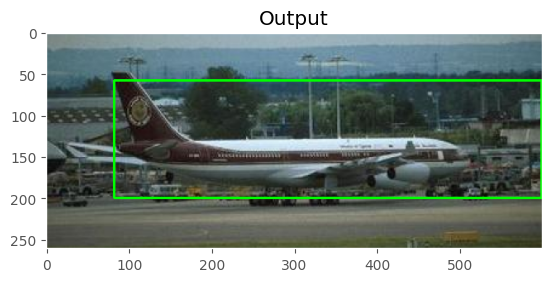

1/1 [==============================] - 0s 25ms/step


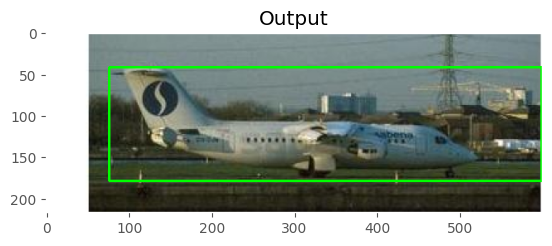

1/1 [==============================] - 0s 28ms/step


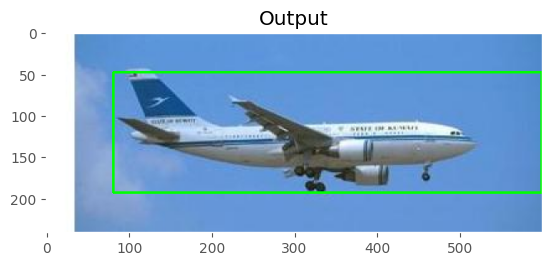

1/1 [==============================] - 0s 29ms/step


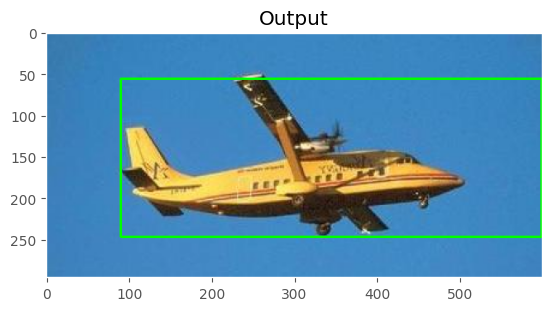

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# load our trained bounding box regressor from disk
print("[INFO] loading object detector...")
model = load_model(config.MODEL_PATH)

# loop over the images that we'll be testing using our bounding box
# regression model
for imagePath in imagePaths:
    # load the input image (in Keras format) from disk and preprocess
    # it, scaling the pixel intensities to the range [0, 1]
    image = load_img(imagePath, target_size=(224, 224))
    image = img_to_array(image) / 255.0
    image = np.expand_dims(image, axis=0)

    # make bounding box predictions on the input image
    preds = model.predict(image)[0]
    (startX, startY, endX, endY) = preds

    # load the input image (in OpenCV format), resize it such that it
    # fits on our screen, and grab its dimensions
    image = cv2.imread(imagePath)
    image = imutils.resize(image, width=600)
    (h, w) = image.shape[:2]

    # scale the predicted bounding box coordinates based on the image
    # dimensions
    startX = int(startX * w)
    startY = int(startY * h)
    endX = int(endX * w)
    endY = int(endY * h)

    # draw the predicted bounding box on the image
    cv2.rectangle(image, (startX, startY), (endX, endY), (0, 255, 0), 2)

    # Convert the OpenCV image to RGB format for Matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the output image using Matplotlib
    plt.figure()
    plt.imshow(image_rgb)
    plt.title("Output")
    plt.axis('off')
    plt.show()